In [1]:
import pandas as pd 
import numpy as np # Both pandas and numpy libraries are for data storage and manipulation
import matplotlib.pyplot as plt # For plotting
import datetime as dt # To declare datetime objects
import pytz # To set timezones to datetime objects
import sklearn.linear_model as lm
from sklearn.svm import SVR, LinearSVR
from sklearn.metrics import mean_squared_error
from tqdm import tqdm
from collections import deque
from sklearn.cluster import KMeans
from mpl_toolkits import mplot3d
from sklearn import decomposition
%matplotlib inline

In [2]:
df = pd.read_csv('dataport-export_gas_oct2015-mar2016.csv')
df['localminute'] = df['localminute'].astype(str).str[:-3]
df["localminute"] = pd.to_datetime(df.localminute)

In [3]:
a = dt.datetime(2016,2,1) 
b = dt.datetime(2016,1,1)
id_label = df[(df['localminute']<a)&(df['localminute']>=b)]['dataid'].unique() # declaring datetime objects such that we can
len(id_label)                                                   # filter meters/houses that don't have any readings in January

148

In [4]:
# This code section performs the backward proportional distribution

hourly_aggregation_month = [[0]*len(id_label)]*24*31
hourly_aggregation_month = np.array(hourly_aggregation_month)

for index, data_id in enumerate(tqdm(id_label)):
    current_timestamp= pd.array(df[df['dataid'] == data_id]['localminute'])
    current_meter_readings = np.array(df[df['dataid'] == data_id]['meter_value'].diff().dropna())
    for ind, reading in enumerate(current_meter_readings):
        if reading>0: # Ensure that we only distribute positive change, since negative changes are treated as error/malfunctions
            current_year = current_timestamp[ind+1].year
            current_month = current_timestamp[ind+1].month
            current_hour = current_timestamp[ind+1].hour
            current_day = current_timestamp[ind+1].day
            time_delta_from_previous = current_timestamp[ind+1] - current_timestamp[ind]
            hour_delta_from_previous = time_delta_from_previous.days*24 + time_delta_from_previous.seconds/3600
            time_delta_from_hour = current_timestamp[ind+1] - current_timestamp[ind+1].floor('H')
            hour_delta_from_hour = time_delta_from_hour.seconds/3600


            if current_month == 1:
                if hour_delta_from_previous>hour_delta_from_hour:
                    now = current_timestamp[ind+1]
                    hour = now.floor('H')
                    change = now - hour
                    
                    while change.seconds!=0 and (current_hour + (current_day-1)*24) >=0:
                        fraction = (change.seconds/3600) / hour_delta_from_previous
                        distributed_reading = round(reading * fraction) # distribute usage based on how many hours from current timestamp to the nearest rounded down hour
                        hourly_aggregation_month[current_hour + (current_day-1)*24,index]+= distributed_reading
                        current_hour = current_hour-1 # current hour here acts as a counter to count how many hours from now to the first day of january
                        now = hour
                        hour = hour - pd.Timedelta(hours=1) if hour - pd.Timedelta(hours=1) > current_timestamp[ind] else current_timestamp[ind]
                        change = now - hour # however this loop will terminate when the change is already zero, i.e. when we reach the timestamp before
                else:
                    hourly_aggregation_month[current_hour + (current_day-1)*24,index]+= reading

100%|████████████████████████████████████████████████████████████████████████████████| 148/148 [01:53<00:00,  1.30it/s]


In [5]:
hourly_aggregation_month = pd.DataFrame(hourly_aggregation_month,columns=id_label,index=range(24*31)) 
initial_reading = []
for data_id in id_label:
    meter_readings = np.array(df[df['dataid'] == data_id]['meter_value'])
    initial_reading.append(meter_readings[0])

In [6]:
hourly_aggregation_month

,1589,7287,2018,7989,1801,3527,4514,2034,8156,4998,...,9160,8244,2755,9600,2946,1403,7566,6673,2814,6101
0,12,0,0,0,0,10,20,1,2,48,...,0,0,0,0,0,0,0,0,0,0
1,18,0,2,0,2,11,24,3,0,50,...,0,0,0,0,0,0,0,0,0,0
2,48,16,2,0,0,15,21,16,0,47,...,0,0,0,0,0,0,0,0,0,0
3,0,6,6,2,0,15,15,14,0,48,...,0,0,0,0,0,0,0,0,0,0
4,17,18,22,3,0,15,15,0,2,47,...,0,0,0,0,0,0,0,0,0,0
5,49,0,12,19,3,23,25,18,0,43,...,0,0,0,0,0,0,0,0,0,0
6,0,18,81,16,48,29,43,14,0,24,...,0,0,0,0,0,0,0,0,0,0
7,50,3,78,14,62,20,16,14,0,19,...,0,0,0,0,0,0,0,0,0,0
8,20,11,47,0,30,18,24,18,0,24,...,0,0,0,0,0,0,0,0,0,0
9,2,12,7,32,5,17,30,13,2,38,...,0,0,0,0,0,0,0,0,0,0


In [7]:
hourly_aggregation_month_total = [[0]*len(id_label)]*24*31
hourly_aggregation_month_total = pd.DataFrame(hourly_aggregation_month_total)
for i in range(len(id_label)):
    initial = initial_reading[i]
    for j in range(24*31):
        try:
            initial += hourly_aggregation_month.iloc[j,i]
            hourly_aggregation_month_total[i][j] = initial
        except IndexError:
            print(i,",", j)
            

In [8]:
hourly_aggregation_month_total.columns = id_label
hourly_aggregation_month_total

,1589,7287,2018,7989,1801,3527,4514,2034,8156,4998,...,9160,8244,2755,9600,2946,1403,7566,6673,2814,6101
0,193934,221038,204482,110614,110108,235124,382186,72377,251820,163040,...,173408,98904,348670,121172,156164,72206,132318,80138,169986,114832
1,193952,221038,204484,110614,110110,235135,382210,72380,251820,163090,...,173408,98904,348670,121172,156164,72206,132318,80138,169986,114832
2,194000,221054,204486,110614,110110,235150,382231,72396,251820,163137,...,173408,98904,348670,121172,156164,72206,132318,80138,169986,114832
3,194000,221060,204492,110616,110110,235165,382246,72410,251820,163185,...,173408,98904,348670,121172,156164,72206,132318,80138,169986,114832
4,194017,221078,204514,110619,110110,235180,382261,72410,251822,163232,...,173408,98904,348670,121172,156164,72206,132318,80138,169986,114832
5,194066,221078,204526,110638,110113,235203,382286,72428,251822,163275,...,173408,98904,348670,121172,156164,72206,132318,80138,169986,114832
6,194066,221096,204607,110654,110161,235232,382329,72442,251822,163299,...,173408,98904,348670,121172,156164,72206,132318,80138,169986,114832
7,194116,221099,204685,110668,110223,235252,382345,72456,251822,163318,...,173408,98904,348670,121172,156164,72206,132318,80138,169986,114832
8,194136,221110,204732,110668,110253,235270,382369,72474,251822,163342,...,173408,98904,348670,121172,156164,72206,132318,80138,169986,114832
9,194138,221122,204739,110700,110258,235287,382399,72487,251824,163380,...,173408,98904,348670,121172,156164,72206,132318,80138,169986,114832


## Alternate representation of monthly consumption data

Find average of all hourly cumulative meter reading in each day of the month. Output for each meter will be 24 hrs instead of 744 hrs. This would be used later as an alternative way of regression

In [9]:
alt_hourly_aggregation_month_total = [[0]*len(id_label)]*24
alt_hourly_aggregation_month_total = pd.DataFrame(alt_hourly_aggregation_month_total, columns=id_label)
for meterid in tqdm(hourly_aggregation_month_total.columns):
    curr_meters = hourly_aggregation_month_total[meterid].values
    for i in range(24):
        for j in range(31):
            alt_hourly_aggregation_month_total[meterid][i] += curr_meters[i + j*24]
        alt_hourly_aggregation_month_total[meterid][i] //= 31

100%|████████████████████████████████████████████████████████████████████████████████| 148/148 [00:07<00:00, 18.70it/s]


In [10]:
alt_hourly_aggregation_month_total

,1589,7287,2018,7989,1801,3527,4514,2034,8156,4998,...,9160,8244,2755,9600,2946,1403,7566,6673,2814,6101
0,201047,223932,209801,113129,113653,239782,387275,75012,255971,168776,...,174846,100054,350449,122368,157804,72572,133504,80606,170810,115129
1,201068,223937,209806,113130,113654,239796,387288,75015,255977,168792,...,174851,100055,350458,122372,157811,72573,133509,80609,170814,115131
2,201093,223944,209812,113130,113655,239811,387301,75020,255987,168808,...,174857,100058,350467,122377,157818,72574,133513,80611,170818,115133
3,201126,223952,209820,113132,113656,239828,387313,75026,255996,168825,...,174863,100059,350476,122383,157826,72574,133518,80615,170822,115135
4,201154,223961,209829,113133,113657,239844,387328,75032,256009,168842,...,174869,100060,350485,122389,157833,72575,133522,80617,170826,115137
5,201183,223970,209849,113148,113658,239861,387356,75042,256046,168859,...,174876,100069,350494,122396,157841,72577,133527,80619,170830,115139
6,201217,223983,209916,113169,113687,239882,387393,75056,256068,168882,...,174882,100085,350502,122404,157848,72580,133532,80622,170834,115141
7,201248,224000,209984,113192,113741,239908,387416,75066,256087,168913,...,174889,100098,350509,122412,157856,72583,133536,80627,170838,115143
8,201275,224011,210012,113204,113765,239926,387437,75079,256096,168933,...,174898,100108,350515,122420,157863,72586,133541,80634,170842,115145
9,201296,224021,210025,113211,113775,239941,387455,75091,256106,168952,...,174905,100114,350520,122426,157870,72588,133545,80636,170846,115147


## Section 2: Forecasting
In Section 1, we have dealt with data pre-processing. The 2 'data' that are of interest are the hourly gas consumption and the cumulative hourly gas consumption. We have sectioned out the data for each meter, for the period of January 2016. As what we have done in the previous assignment, the next step is to make predictions using these data. From Section 1, it is clear that the data we are dealing with is continuous in nature. Hence the problem faced in this section would be a regression problem

In this section, the prediction that we are interested in would be to predict the hourly readings in the next hour. This means that it would be the **cumulative gas consumption** that we would be predicting. Hence we would be using the data from Section 1.2b). For the purpose of prediction, we will consider 2 methods: Linear Regression and Support Vector Regression. Furthermore, our assumption here would be that the hourly readings have some time dependency. This would be explained in detail later when we set the assumptions and reasoning when applying the 2 methods for prediction.

### 2.1. Uses of Forecasting
Before getting into the details of the prediction, we would first give some background information as to the use of making such predictions. Some of the questions that can be asked are:

#### a) Why would we want to forecast the hourly readings (and to that extent the gas consumption) in the future?
There are several reasons as to why this is useful.

1. In recent years, natural gas has gained popularity as a choice for power generation and manufacturing. This is because it is relatively safe towards the environment, and is also lower in cost. Its popularity has grown especially in developing countries like China. For instance, in 2012, gas consumption in China was 147.1 billion cubic meters [http://dx.doi.org/10.1155/2014/980410], which is an increase of 13% compared to the previous years. This rise in gas consumption would demand a development in pipeline constructions and maintenance. As such, being able to predict gas consumption trends over different regions would thus allow the relevant parties like the government to efficiently allocate their resources to the development of infrastructures such as the abovementioned gas pipelines, to areas where gas consumptions are predicted to be high, such as to allow smooth flow of gas towards the consumers.

2. Being able to predict gas consumption over a certain area also aids in regulating the production and distribution of natural gas. Since natural gas is a limited natural resource, forecasting would provide information on how much gas should be produced and distributed at different times. This would aid companies who deal with extracting and processing raw natural gas.

3. Extending from the previous point, being able to predict trends in gas consumption will also help gas distribution companies to manage their supply and demands. For instance, being able to predict when gas consumptions are high will allow such companies to order their supply in bulk, and also ahead of time (which can also reduce costs of logistics). Then, in terms of distribution, being able to predict the trends will also allow them to optimise pricings based on demands.


#### b) Who would find these information valuable?
As stated in part a), some parties that would benefit from such predictions are
1. Gas provider companies like Singapore LNG Corp
2. Gas distribution companies
3. Government as well as researchers on the area of environmental effects of natural gas

#### c) What can we do if we have a good forecasting model?
With respect to part a), some applications of a good forecasting model for the relevant parties are as follows:
1. For government in developing countries, being able to predict the gas consumptions in different cities would allow efficient allocation of resources towards building the infrastructure such as gas pipelines, in areas where gas consumption is higher.

2. For gas processing companies, being able to predict gas consumption would allow them to predict demands at different times and adjust their production quantity accordingly so as to not only reduce possible harms to the environment by extracting natural gas in excess, but also to save costs and possibly maximise profits

3. For gas distribution companies, predicting consumer's gas consumption would assist them in managing supply and demand, such as ordering in advance and in bulk, and regulate pricings based on this prediction

4. Finally, predictions made by such forecasting model can also be integrated into researches conducted on impact of using natural gas on the environment. By being able to predict the gas consumptions in the future, environmental researchers could thus predict the impact of such consumption patterns into the future. For example, with future gas consumption predictions they might be able to predict the severity of global warming in the future, following this gas consumption pattern.

### 2.2 Forecasting by Regression
In this section, we would perform linear regression and support vector regression on the data from section 1.2b), to predict the meter reading in the next hour. Before going to the predictions, we will elaborate on how we would conduct the regression, stating the assumptions that we made.

The assumption we make is that the hourly meter reading has some dependency with time. This implies 2 things. Firstly, this means that predicting the meter reading in the next hour is not a sufficient input for prediction. The exact time to be predicted must also be specified, i.e. predicting the next hour's reading from 1st January 12.00 (hence predicting the reading at 13.00) is not the same as predicting the next hour's reading from 2nd January 12.00 (which is 13.00 at 2nd January). For the purpose of this assignment, with regards to the question posed in the project document, we will assume that the next hour refers to the next hour at the end of the month that we are studying (i.e. hour 744) . The second implication is that since the meter reading is dependent on time, it is highly probable that the trend would change over the month being studied. Hence, if we simply use all the hourly readings in that month (i.e. from hour 0 to 743) and predict for hour 744, this won't be accurate, since our single model would encompass different trends inside that month. Hence, for each prediction (i.e. Linear Regression and Support Vector Regression), we would define a quantity n, which is the number of prior hours to consider to make the prediction for the next hour. Then we would try out different values of n, and for each n, we split our data into training and test data according to this n. Finally, we will perform training and prediction on each 'batch' of this split (similar to ensemble predictions) and average out the mean squared errors from each batch. This error would be the metric for rating how good this value of n is. Then we would select the n which has the least mean squared error, and we use this to make prediction on the next hour. An illustration of this is as follows:
1. Suppose we choose n = 2. Then with the 744 hours in our training data, we split it as follows:

    - Use hour 0 and 1 as training, predict for hour 2. Compare the predicted reading with the actual reading of hour 2 and obtain the squared error.
    
    - Then use actual hour 1 and hour 2 as training, and predict for hour 3. Again, compare the predicted reading of hour 3 with the actual reading of hour 3 and obtain the squared error.
    
    - Repeat the above step for all the hours in the month, i.e. until using hour 741 and 742 to predict 743. Then sum all the errors of all these batch predictions and average them. This will be the error for n=2


2. Then repeat step 1, trying out different values of n. In studying a month, the maximum number of n would be theoretically 743 and the minimum would be 2 (if n = 1, not suffient to only have 1 training data to predict the next). Record the mean squared error for each n, and then choose the one with the lowest mean squared error. This n would then be used to predict the next hour

This would be the general framework that we follow while making predictions. For linear regression, the additional parameter that we vary would be the order of the polynomial (we would also try out different polynomial orders to see whether they would do better). For support vector regression, we use RBF kernel, and we only vary n (no additional parameter varied). Finally, we would perform the above predictions for each meter, so as to not confound our predictions with factors like meter location, etc.

#### 2.2a) Linear Regression
In this section, we would perform the above regression, using linear regression method. In a nutshell, linear regression (and polynomial regression in general) attempts to fit a line (or polynomial curve) that would minimise the mean squared error with the training data. For the purpose of regression in this assignment, we would use **ridge** regression instead of usual linear regression, because as seen in Assignment 1, we saw that Ridge Regression (with cross validation for the ridge parameter lambda) generalizes better to unseen data (i.e. less overfitting) than normal linear regression.

The following code section performs the 'batch' prediction to obtain the best n value. For the purpose of cutting down code running time, we limit the number of 'batches' for each n, to be 200. Furthermore, we only try out n values from 2 to 24 hours, because our model only requires an hourly resolution of 1 hour. If we wish to increase the hourly resolution of our model, we will have to change the range of n to contain larger values. The reason for limiting the number of batches for each n, is because otherwise, as n increases, then there would be less batches. Hence, the number of batches could potentially affect the mean squared error; hence it won't be a fair comparison between different values of n. Since we only try n values between 2 to 24, 200 is a reasonable number because all values of n from 2 to 24 would give more than 200 batches, hence it is guaranteed that each n value gives 200 batches.

Finally, for each n, we also perform prediction for each batch by using 3 polynomial degrees, i.e. degree 1 to 3 inclusive. We record the mean squared error for each polynomial degree seperately, and at the end of all the iterations, we would select the best n, as well as the best polynomial degree for that value of n. This would be done for all meters (the best value of n and the corresponding best polynomial degree will be different for each meter). Note that best means least mean squared error.

In [11]:
ridge = lm.RidgeCV()
np_dict = dict() # key is meter_id, value is tuple in the form of (n,p)
for meter_id in tqdm(id_label, position=0):
    curr_hourly_month_meter = hourly_aggregation_month_total[meter_id]
    N_dict = dict()
    # looking for the optimal value of N between 2 hrs and 24 hrs
    for N in range(2,25):
        mse_arr = [0]*3
        num_models = 200 # The number of models to create to find the average MSE
        for i in range(num_models):
            time_train = [x for x in range(i, i+N)]
            meter_train = curr_hourly_month_meter[i:i+N]
            meter_true = curr_hourly_month_meter[i+N]
            for p in range(1, 4):
                ridge.fit(np.vander(time_train, p+1), meter_train)
                meter_pred = ridge.predict(np.vander([i+N], p+1))
                mse = abs(meter_true-meter_pred)**2
                mse_arr[p-1] += mse
        mse_arr = [x/num_models for x in mse_arr]
        min_mse = min(mse_arr)
        min_p = mse_arr.index(min_mse) + 1
        N_dict[N] = (min_mse, min_p)
    min_n = min(N_dict, key=N_dict.get)
    np_dict[meter_id] = (min_n, N_dict[min_n][1])

100%|████████████████████████████████████████████████████████████████████████████████| 148/148 [20:43<00:00,  8.58s/it]


The results of searching the best n and the corresponding best polynomial degree (p) for each meter is stored in a dictionary data type, printed below. E.g. from the results below, for meter id 1589, the best n value (from 2 to 24) is 6, and the corresponding best polynomial degree is 1.

In [12]:
np_dict

{1589: (6, 1),
 7287: (3, 1),
 2018: (2, 2),
 7989: (2, 2),
 1801: (2, 2),
 3527: (2, 2),
 4514: (2, 2),
 2034: (4, 2),
 8156: (2, 2),
 4998: (2, 2),
 484: (3, 3),
 1507: (3, 2),
 8386: (2, 2),
 1718: (3, 1),
 5814: (3, 1),
 739: (2, 2),
 9134: (2, 2),
 7017: (3, 1),
 7794: (2, 2),
 187: (2, 2),
 35: (3, 1),
 7030: (2, 2),
 2094: (3, 1),
 871: (3, 1),
 3635: (2, 2),
 5636: (2, 2),
 9295: (3, 1),
 7674: (2, 2),
 1800: (2, 1),
 4029: (2, 2),
 5810: (3, 1),
 3893: (3, 2),
 5131: (3, 1),
 8890: (2, 2),
 4031: (2, 2),
 6910: (3, 2),
 5403: (3, 1),
 1042: (2, 2),
 2965: (2, 2),
 3918: (2, 2),
 2449: (3, 1),
 1185: (3, 1),
 1086: (3, 2),
 3134: (2, 2),
 5892: (2, 1),
 1790: (2, 2),
 9982: (2, 2),
 8829: (2, 2),
 4732: (2, 2),
 7739: (2, 2),
 2072: (2, 2),
 1714: (2, 2),
 7117: (3, 1),
 94: (2, 2),
 5129: (2, 2),
 2335: (2, 2),
 2129: (2, 2),
 483: (2, 2),
 5193: (2, 2),
 370: (2, 2),
 8155: (5, 1),
 8084: (2, 2),
 1697: (2, 2),
 3577: (2, 2),
 9639: (2, 2),
 7429: (2, 2),
 8059: (2, 2),
 3723

#### Analysis of Quality Of Prediction from Linear Regression
Then after finding the best n and p values for each meter, we proceed to generate time-series plots. Following the framework defined above, to generate the time-series plots for each meter, we perform the following:
- Using the n value found above, we split the training data into batches and make batch predictions as explained above. E.g. for meter 8386, best n value is 2, and p value is 2. In this case, we would split training data as hour 0 and 1, make prediction for hour 2, then hour 1 and 2, make prediction for 3 etc. In a sense to generate a point at any hour, e.g. x, we take the **actual** meter reading of the previous 2 hours, i.e. x-1 and x-2. Then we train using a polynomial of degree 2 using these 2 hours, to predict x. This **predicted** x would be the point we plot on the time-series from our prediction. We do the above for each hour in the month, and for each meter.
- Note that we do not use predicted values to make subsequent hour predictions. E.g. if n=2, use actual reading at hour 0 and 1 to predict hour 2. Then we do **not** use actual hour 1 and **predicted** hour 2 reading to predict hour 3. Instead, we used the **actual** hour 1 and **actual** hour 2 reading to predict hour 3. This is because, if we use the former method, then errors from prior predictions would accumulate in later predictions.

Then, the resulting time-series plot for our prediction, is superimposed to the hourly cumulative reading graph for each meter obtained in Section 1.2b). Finally, as means to gauge how good our prediction is, we will plot a scatter plot between the actual values on the vertical axis vs the predicted value on the horizontal axis (hence in this plot, there are no temporal elements on the axes). Theoretically, if our predicted values are exactly same as the actual values, then the second plot would be a line with gradient of 1 and y-intercept of 0 (i.e. pass through the origin). Hence, to measure how good our predictions are, we would also plot a y=x line (red line), and the better our predictions are, the closer will our scatter points be to this line. These are done in the following code sections

100%|████████████████████████████████████████████████████████████████████████████████| 148/148 [01:18<00:00,  1.92it/s]


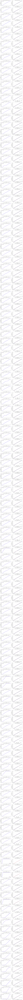

In [13]:
fig,ax = plt.subplots(len(np_dict),2, figsize=(15,5*len(np_dict)))
plt.subplots_adjust(hspace = 0.3)
for idx, entry in enumerate(tqdm(np_dict.items(), position=0)):
    meter_id, np_tuple = entry
    curr_hourly_month_meter = hourly_aggregation_month_total[meter_id]
    length = len(curr_hourly_month_meter)
    N = np_tuple[0]
    p = np_tuple[1]
    time_plot = [x for x in range(N, length)]
    meter_pred = []
    meter_true = curr_hourly_month_meter[N:length]
    for i in range(length-N):
        time_train = [x for x in range(i, i+N)]
        meter_train = curr_hourly_month_meter[i:i+N]
        ridge.fit(np.vander(time_train, p+1), meter_train)
        meter_pred.append(ridge.predict(np.vander([i+N], p+1)))
    ax[idx][0].set_title('Time series plot of Meter ' + str(meter_id) + ' in January')
    ax[idx][0].plot(time_plot, meter_true, 'r-', label='true')
    ax[idx][0].plot(time_plot, meter_pred, 'b-', label='predicted')
    ax[idx][0].legend()
    ax[idx][0].set_xlabel('Time')
    ax[idx][0].set_ylabel('Meter reading')
    ax[idx][1].set_title('Scatter plot of Meter ' + str(meter_id) + ' in January')
    ax[idx][1].scatter(meter_true, meter_pred, marker='.')
    ax[idx][1].set_xlabel('Actual reading')
    ax[idx][1].set_ylabel('Predicted reading')
    m, c = np.polyfit(meter_true, meter_pred, 1)
    ax[idx][1].plot(meter_true, meter_true, 'r-')
    try:
        ax[idx][1].text(0.8, 0.3, 'y = '+str(round(m[0], 5))+'x + '+ str(round(c[0], 5)), horizontalalignment='center', verticalalignment='center', transform=ax[idx][1].transAxes)
    except:
        ax[idx][1].text(0.8, 0.3, 'y = '+str(round(m, 5))+'x + '+ str(round(c, 5)), horizontalalignment='center', verticalalignment='center', transform=ax[idx][1].transAxes)

As seen from the left hand side plots above, our predictions following this framework is very close to the actual value (the true values are plotted in red-line whereas the prediction is plotted in blue line, however the 2 plots are very close to each other hence they superimpose each other). Hence, it is not easy for us to examine how well our predictions are.

This is more easily observed in the plot on the right hand side. The right hand side plots the scatter plot defined above in blue dots, and a reference y=x line in red line. We also display the equation of a best fit line through the scatter plot, to measure the overall quality of our prediction (if the best fit line is y=x, that means that it is a good indication that our predictions are close to the true value, although sometimes this might not be the case, e.g. if the deviation above and below the y=x are large but of equal distance, then y=x would still be 'best fit' line). The better way to gauge quality of prediction based on these plots are to see how far our points are from the y=x line. As seen from the plots, for most meters, our predictions lie very close to y=x, but for some meters, there are points that are quite far from this line. For instance, for meter 8084, there are 2 points that are noticeably far from y=x. E.g.2 for meter 8967 there are a total of 5 points that lie noticeably far from y=x. Overall, this framework of prediction using linear regression is quite satisfactory. Next, we would compare the above prediction vs using Support Vector Regression

#### 2.2b) Support Vector Regression (SVR)

In this section, we would perform the same regression as in Section 2.2a), but with Support Vector Regression. Support Vector Regression is an extension of Support Vector Machines, performed for regression task instea of classification. In a nutshell, Support Vector Regression attempts to find a hyperplane equation (similar to the decision boundary in SVM). However, the difference is that in SVR, we consider a parameter called the threshold (epsilon), and the 'support vector' hyperplanes are placed parallel to the 'decision boundary' hyperplane by a 'distance equal' to this epsilon. Then, points that lie outisde the region enclosed by the 2 parallel support vector hyperplanes are considered as errors (points that lie inside this region, but **not** on the decision boundary hyperplane are not considered as errors). The goal of SVR is thus to find the decision boundary hyperplane, such that given a value of epsilon, the error is minimised. Decreasing the value of epsilon would increase stringency on difference from the decision boundary hyperplane, and hence fitting more to training data, and vice versa.

In this section, we will use RBF kernel, with default epsilon value. The only parameter that we will be changing is n, and for the same reasons as linear regression, we only explore n values from 2 to 24, and limiting the number of batches for each n value to be 200. The criterion for selecting the best n would still be least mean squared error. Note that the reason for choosing RBF kernel is because it is the fastest given our framework of finding the best n. The following code section finds the best n value for each meter, by using RBF kernel.

In [14]:
np_dict_svr = dict() # key is meter_id, value is N
svr = SVR(kernel='rbf', gamma='scale')
for meter_id in tqdm(id_label, position=0):
    curr_hourly_month_meter = hourly_aggregation_month_total[meter_id]
    N_dict = dict()
    # looking for the optimal value of N between 2 hrs and 24 hrs
    for N in range(2,25):
        mse = 0
        num_models = 200 # The number of models to create to find the average MSE
        for i in range(num_models):
            time_train = [[x] for x in range(i, i+N)]
            meter_train = curr_hourly_month_meter[i:i+N]
            meter_true = curr_hourly_month_meter[i+N]
            svr.fit(time_train, meter_train)
            meter_pred = svr.predict([[i+N]])
            mse += abs(meter_true-meter_pred)**2
        N_dict[N] = mse/num_models
    min_n = min(N_dict, key=N_dict.get)
    np_dict_svr[meter_id] = min_n

100%|████████████████████████████████████████████████████████████████████████████████| 148/148 [04:45<00:00,  1.83s/it]


Just like in Linear Regression, the best n value are stored in a key-value (dictionary) data type, with the meter ID being the key, and the n value being the value, as shown below

In [15]:
np_dict_svr

{1589: 2,
 7287: 2,
 2018: 2,
 7989: 2,
 1801: 2,
 3527: 2,
 4514: 2,
 2034: 2,
 8156: 2,
 4998: 2,
 484: 2,
 1507: 2,
 8386: 2,
 1718: 2,
 5814: 2,
 739: 2,
 9134: 2,
 7017: 2,
 7794: 2,
 187: 2,
 35: 2,
 7030: 2,
 2094: 2,
 871: 2,
 3635: 2,
 5636: 2,
 9295: 2,
 7674: 2,
 1800: 2,
 4029: 2,
 5810: 2,
 3893: 2,
 5131: 2,
 8890: 2,
 4031: 2,
 6910: 2,
 5403: 2,
 1042: 2,
 2965: 2,
 3918: 2,
 2449: 2,
 1185: 2,
 1086: 2,
 3134: 2,
 5892: 2,
 1790: 2,
 9982: 2,
 8829: 2,
 4732: 2,
 7739: 2,
 2072: 2,
 1714: 2,
 7117: 2,
 94: 2,
 5129: 2,
 2335: 2,
 2129: 2,
 483: 2,
 5193: 2,
 370: 2,
 8155: 2,
 8084: 2,
 1697: 2,
 3577: 2,
 9639: 2,
 7429: 2,
 8059: 2,
 3723: 2,
 7900: 2,
 744: 2,
 8086: 2,
 9849: 2,
 9278: 2,
 1556: 2,
 7682: 2,
 2945: 2,
 6836: 2,
 1791: 2,
 4296: 2,
 5785: 2,
 9729: 2,
 8967: 2,
 4767: 2,
 44: 2,
 1283: 2,
 6412: 2,
 5439: 2,
 5275: 2,
 252: 2,
 114: 2,
 4356: 2,
 4193: 2,
 2461: 2,
 3367: 2,
 77: 2,
 5395: 2,
 2575: 2,
 9121: 2,
 3310: 2,
 3544: 2,
 9956: 2,
 6578: 

#### Analysis of Quality of Prediction by SVR

Then, just like in Linear Regression, to assess the quality of prediction, we generate 2 plots, time-series plot of our prediction vs the actual value, and the scatter plot of the predicted value on the horizontal axis, vs the actual value on the vertical axis. The prediction time-series is generated in the same manner as in the Linear Regression section, i.e. using the **actual** values for n prior hours to predict the current hour, and doing it for all hours in the month. On the same plot, we superimpose the time series based on the true value obtained in Section 1.2b)

The same criterion can also be used to measure the 'goodness' of our prediction from the scatter plot, i.e. the closer the points are to y=x, the better our prediction is. The plotting is done in the following code section

100%|████████████████████████████████████████████████████████████████████████████████| 148/148 [00:53<00:00,  2.72it/s]


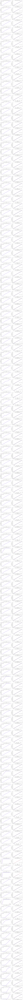

In [16]:
fig,ax = plt.subplots(len(np_dict_svr),2, figsize=(15,5*len(np_dict_svr)))
plt.subplots_adjust(hspace = 0.3)
for idx, entry in enumerate(tqdm(np_dict_svr.items(), position=0)): # Originally to be np_dict_svr
    meter_id, N = entry
    curr_hourly_month_meter = hourly_aggregation_month_total[meter_id]
    length = len(curr_hourly_month_meter)
    time_plot = [x for x in range(N, length)]
    meter_pred = []
    meter_true = curr_hourly_month_meter[N:length]
    for i in range(length-N):
        time_train = [[x] for x in range(i, i+N)]
        meter_train = curr_hourly_month_meter[i:i+N]
        svr.fit(time_train, meter_train)
        meter_pred.append(svr.predict([[i+N]]))
    ax[idx][0].set_title('Time series plot of Meter ' + str(meter_id) + ' in January')
    ax[idx][0].plot(time_plot, meter_true, 'r-', label='true')
    ax[idx][0].plot(time_plot, meter_pred, 'b-', label='predicted')
    ax[idx][0].legend()
    ax[idx][0].set_xlabel('Time')
    ax[idx][0].set_ylabel('Meter reading')
    ax[idx][1].set_title('Scatter plot of Meter ' + str(meter_id) + ' in January')
    ax[idx][1].scatter(meter_true, meter_pred, marker='.')
    ax[idx][1].set_xlabel('Actual reading')
    ax[idx][1].set_ylabel('Predicted reading')
    m, c = np.polyfit(meter_true, meter_pred, 1)
    ax[idx][1].plot(meter_true, meter_true, 'r-')
    try:
        ax[idx][1].text(0.8, 0.3, 'y = '+str(round(m[0], 5))+'x + '+ str(round(c[0], 5)), horizontalalignment='center', verticalalignment='center', transform=ax[idx][1].transAxes)
    except:
        ax[idx][1].text(0.8, 0.3, 'y = '+str(round(m, 5))+'x + '+ str(round(c, 5)), horizontalalignment='center', verticalalignment='center', transform=ax[idx][1].transAxes)

Just like in Linear Regression, the trends are hard to infer from the plot on the left, because the predicted plot exactly overlaps with the true plot. Hence we infer from the plot on the right. In the SVR case, we can see that some meter's predictions are worse than in the Linear Regression case. For e.g. meter 8967, in SVR there are now 10 points that are away from y=x, and these points are slightly futher away from the line than in the Linear Regression Case. Furthermore, we can also see the worsening in prediction in meters like meter ID 6578, where in the Linear Regression Case, the points lie very close to y=x, whereas in the SVR case, the points at the bottom deviates slightly from y=x. Hence we can conclude that in this case, Ridge Linear Regression (technically polynomial ridge regression) performs better than SVR.

## Alternate Q2 implementation using alternate representation of monthly consumption data

The framework proposed above seemed to have fitted the training data very well, with very high accuracy on most of the meters. However, there is one weakness of this framework. The above framework assumes that we only need to predict the next one hour, and that in generating the time series, for any hour we used the **actual** values for n prior hours from that hour. However, when we are performing actual predictions for e.g. next 5 hours (which means we don't have actual meter values for this 5 hours), then we would use our predictions to make subsequent predictions (e.g. if we get n=2, and only have values for hour 0 and 1, and want to predict hour 2, 3, 4, 5, 6, then we would use actual values at 0 and 1 to predict 2, but to predict hour 3, we would need to use actual value at hour 1 and the predicted value at hour 2). This might lead to an accumulation of error.

In this section, we attempt to explore a more simplistic framework for regression. Our framework goes as follows:

- For the month being studied, we reformat the data such that this month is represented as a 24 hours data for each meter. This is done by averaging the meter value at each hour across the month. E.g. for meter 35, we average out all the values at every 00.00,01.00, 02.00,03.00,...23.00 in the month. The result is that this meter's readings are now represented as 24 values, at every hour up to 24 hours.
- Then for each meter, in the case of linear regression, we find the best polynomial order (from order 1 to 3) to perform regression with. First, we start with order 1, and perform regression by taking the first 23 hours (i.e. hour 0 to 22). Then we validate the error by comparing our prediction for the 24th hour (i.e. hour 23) using this polynomial degree, with the actual value at hour 23 (hence hour 23 is our validation set). We measure the squared error. The selected polynomial degree is thus the one with the least squared error.
- For SVR, we try out different values of C and epsilon, and by inspection, select the one which performs sufficiently well, i.e. it fits the training data quite well. This will be elaborated more in the next parts.

## Linear Regression
As explained above, first we would find the best polynomial degree for each meter (i.e. least squared error). This is done in the code section below

In [17]:
ridge = lm.RidgeCV()
p_dict = dict() # key is meter_id, value is p
for meter_id in tqdm(id_label, position=0):
    curr_hourly_month_readings = alt_hourly_aggregation_month_total[meter_id]
    mse_arr = [0]*3
    time_train = [x for x in range(0, 23)]
    meter_train = curr_hourly_month_readings[:23]
    meter_true = curr_hourly_month_readings[23]
    for p in range(1, 4):
        ridge.fit(np.vander(time_train, p+1), meter_train)
        meter_pred = ridge.predict(np.vander([23], p+1))
        mse = abs(meter_true-meter_pred)**2
        mse_arr[p-1] = mse
    min_mse = min(mse_arr)
    min_p = mse_arr.index(min_mse) + 1
    p_dict[meter_id] = min_p

100%|███████████████████████████████████████████████████████████████████████████████| 148/148 [00:00<00:00, 386.60it/s]


The resulting best polynomial degree for each meter is stored in a dictionary, with the key being the meter ID and the value being the polynomial order, as shown below

In [18]:
p_dict

{1589: 3,
 7287: 3,
 2018: 2,
 7989: 2,
 1801: 2,
 3527: 1,
 4514: 2,
 2034: 2,
 8156: 3,
 4998: 3,
 484: 3,
 1507: 2,
 8386: 2,
 1718: 3,
 5814: 1,
 739: 1,
 9134: 1,
 7017: 3,
 7794: 3,
 187: 1,
 35: 2,
 7030: 1,
 2094: 3,
 871: 1,
 3635: 3,
 5636: 3,
 9295: 2,
 7674: 3,
 1800: 1,
 4029: 3,
 5810: 1,
 3893: 2,
 5131: 1,
 8890: 1,
 4031: 3,
 6910: 3,
 5403: 2,
 1042: 2,
 2965: 3,
 3918: 3,
 2449: 2,
 1185: 3,
 1086: 2,
 3134: 2,
 5892: 3,
 1790: 3,
 9982: 2,
 8829: 3,
 4732: 3,
 7739: 1,
 2072: 3,
 1714: 3,
 7117: 3,
 94: 1,
 5129: 1,
 2335: 1,
 2129: 1,
 483: 3,
 5193: 2,
 370: 2,
 8155: 3,
 8084: 2,
 1697: 2,
 3577: 3,
 9639: 1,
 7429: 2,
 8059: 3,
 3723: 3,
 7900: 3,
 744: 1,
 8086: 2,
 9849: 3,
 9278: 1,
 1556: 3,
 7682: 3,
 2945: 2,
 6836: 2,
 1791: 2,
 4296: 1,
 5785: 2,
 9729: 3,
 8967: 1,
 4767: 3,
 44: 2,
 1283: 2,
 6412: 2,
 5439: 3,
 5275: 3,
 252: 3,
 114: 2,
 4356: 3,
 4193: 2,
 2461: 1,
 3367: 1,
 77: 1,
 5395: 3,
 2575: 2,
 9121: 2,
 3310: 2,
 3544: 3,
 9956: 3,
 6578: 

With these polynomial orders, we then proceed to generate 2 plots just like the previous case: 1. A Time-Series plot between the actual and predicted plot and 2. A scatter plot between the actual vs the predicted values. In this case however, the time series will now only consist of 24 hours, and the scatter plot will only consist of 24 points. To generate the time series for each meter, we use the best polynomial order found above, and train a linear regression model on all the 24 hours in our training data. Then we use this model to 'predict' the values for these 24 hours, and compare this value to the actual meter value for these 24 hours. In a way, this is evaluating our performance on **training** data.

For the scatter plot, it is defined in the same way as the previous section, i.e. predicted value on the vertical axis vs actual value on the horizontal axis. Hence, the quality of prediction could be assessed in the same way, by inspecting how close the scatter points are to y=x line. These are done in the code section below

100%|███████████████████████████████████████████████████████████████████████████████| 148/148 [00:01<00:00, 107.42it/s]


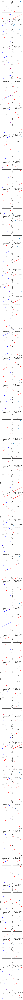

In [19]:
fig,ax = plt.subplots(len(p_dict),2, figsize=(15,5*len(p_dict)))
plt.subplots_adjust(hspace = 0.3)
for idx, entry in enumerate(tqdm(p_dict.items(), position=0)):
    meter_id, p = entry
    curr_hourly_month_readings = alt_hourly_aggregation_month_total[meter_id]
    time_plot = [x for x in range(24)]
    meter_true = curr_hourly_month_readings
    time_train = [x for x in range(23)]
    meter_train = curr_hourly_month_readings[:23]
    ridge.fit(np.vander(time_train, p+1), meter_train)
    meter_pred = ridge.predict(np.vander(time_plot, p+1))
    ax[idx][0].set_title('Time series plot of Meter ' + str(meter_id) + ' in January')
    ax[idx][0].plot(time_plot, meter_true, 'r-', label='true')
    ax[idx][0].plot(time_plot, meter_pred, 'b-', label='predicted')
    ax[idx][0].legend()
    ax[idx][0].set_xlabel('Time')
    ax[idx][0].set_ylabel('Meter reading')
    ax[idx][1].set_title('Scatter plot of Meter ' + str(meter_id) + ' in January')
    ax[idx][1].scatter(meter_true, meter_pred, marker='.')
    ax[idx][1].set_xlabel('Actual reading')
    ax[idx][1].set_ylabel('Predicted reading')
    m, c = np.polyfit(meter_true, meter_pred, 1)
    ax[idx][1].plot(meter_true, meter_true, 'r-')
    try:
        ax[idx][1].text(0.8, 0.3, 'y = '+str(round(m, 5))+'x + '+ str(round(c, 5)), horizontalalignment='center', verticalalignment='center', transform=ax[idx][1].transAxes)
    except:
        ax[idx][1].text(0.8, 0.3, 'y = '+str(round(m[0], 5))+'x + '+ str(round(c[0], 5)), horizontalalignment='center', verticalalignment='center', transform=ax[idx][1].transAxes)

As seen in the plots on the left hand side, the performance on the training data with this framework is noticeably worse than the previous framework. The deviation of the blue plot (predicted) from the red plot (true value) is now noticeable (unlike the previous framework where they superimpose each other).

Furthermore, now we can also observe from the scatter plots, for most of the meters the plots now lie farther away from y=x line. We can see this from the best fit line equation for some of the meters (e.g. meter 871, the best fit line equation has a gradient of 0.856 which is quite far from y=x whose gradient is 1). Although some meters have quite good predictions, e.g. meter 5636, it is still noticeably worse from the predictions in the first framework.

Next, we would try out SVR with the same framework, and see whether we can improve our performance on the training data.

## Support Vector Regression

As explained previously, for SVR the parameter to be varied is C and epsilon. We varied these by inspection and found the one where the fit is sufficiently good for the training data. The trends we observed are:
- Increasing epsilon increases the number of points considered in error calculations. Hence to some extent, increasing epsilon increases the fit towards the training data by reducing number of errors. However, it is limited by the weight we put on penalty of misclassification.
- Increasing C increases the penalty of misclassification, hence it increases the fit towards the training data.

The values we found that give a sufficiently good fit are C=100, epsilon = 0.1. With these values, we proceed to generate the time series and scatter plots following the same method as above.

100%|████████████████████████████████████████████████████████████████████████████████| 148/148 [00:01<00:00, 81.68it/s]


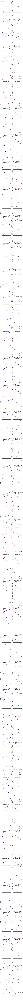

In [20]:
svr = SVR(kernel='rbf', gamma='scale', C=100)
fig,ax = plt.subplots(len(id_label), 2, figsize=(15,5*len(id_label)))
plt.subplots_adjust(hspace = 0.3)
for idx, meter_id in enumerate(tqdm(id_label, position=0)):
    curr_hourly_month_meter = alt_hourly_aggregation_month_total[meter_id]
    time_plot = [x for x in range(24)]
    meter_pred = []
    meter_true = curr_hourly_month_meter
    time_train = [[x] for x in range(23)]
    time_test = [[x] for x in range(24)]
    meter_train = curr_hourly_month_meter[:23]
    svr.fit(time_train, meter_train)
    meter_pred = svr.predict(time_test)
    ax[idx][0].set_title('Time series plot of Meter ' + str(meter_id) + ' in January')
    ax[idx][0].plot(time_plot, meter_true, 'r-', label='true')
    ax[idx][0].plot(time_plot, meter_pred, 'b-', label='predicted')
    ax[idx][0].legend()
    ax[idx][0].set_xlabel('Time')
    ax[idx][0].set_ylabel('Meter reading')
    ax[idx][1].set_title('Scatter plot of Meter ' + str(meter_id) + ' in January')
    ax[idx][1].scatter(meter_true, meter_pred, marker='.')
    ax[idx][1].set_xlabel('Actual reading')
    ax[idx][1].set_ylabel('Predicted reading')
    m, c = np.polyfit(meter_true, meter_pred, 1)
    ax[idx][1].plot(meter_true, meter_true, 'r-')
    try:
        ax[idx][1].text(0.8, 0.3, 'y = '+str(round(m, 5))+'x + '+ str(round(c, 5)), horizontalalignment='center', verticalalignment='center', transform=ax[idx][1].transAxes)
    except:
        ax[idx][1].text(0.8, 0.3, 'y = '+str(round(m[0], 5))+'x + '+ str(round(c[0], 5)), horizontalalignment='center', verticalalignment='center', transform=ax[idx][1].transAxes)

In the SVR case, we managed to achieve a better fit on the training data. For instance, from the plots on the left, for meter ID 871 the fit is much better as compared to the Linear Regression Case. We can also see the improvement in quality of fit from the scatter plots on the right. In general, the scatter plots for many of the meter sees an improvement, in that the points now lie closer to y=x line. For instance, meter ID 871, the best fit line equation now has a gradient of 0.954 and a smaller y-intercept, which somewhat implies that the points now lie closer to y=x line (note that this could also be found by inspection).

However, this could be attributed to us forcing a large value of C. The equivalent procedure on linear regression would be to increase the polynomial order (since we only considered polynomial degree 1 to 3, if we had considered higher polynomial orders, we would obtain a better fit). But for the current results, we can say that SVR performs better than Linear Regression. And we can also conclude that the previous method framework performs better (the step-wise prediction) than this framework, but relies heavily on actual prior data.

## Section 3: Student Proposal

### Proposal 1: Backflow magnitude

In this section, we will be investigating meters backflow occurrences as well as analysing the cumulative backflow magnitudes. A cost effective strategy will also be discussed to determine the approach towards repairing defective meters based on the findings from analysing the above occurrences.

Find number of unique IDs

In [21]:
df_id = df.loc[:,'dataid']
df_id.nunique()

157

We create a copy of the original dataframe and do the necessary manipulations on the 'localminute' column, so that the timezones in the timestamps are disregarded. This is because the timezones found in the timestamps were determined and explained previously to be meaningless.
Additionally, we sort the dataframe by the meter ID and localminute.

In [22]:
df2 = df.copy()

df2['localminute'] = df2['localminute'].astype(str).str[:-3]
df2["localminute"] = pd.to_datetime(df2.localminute)

df2 = df2.sort_values(by=['dataid','localminute'])
print(df2.head(20))
print(df2.tail(20))

             localminute  dataid  meter_value
83   2015-10-01 00:14:44      35        93470
244  2015-10-01 00:42:34      35        93470
723  2015-10-01 02:02:37      35        93470
790  2015-10-01 02:12:38      35        93470
829  2015-10-01 02:20:36      35        93470
852  2015-10-01 02:23:39      35        93470
1418 2015-10-01 03:59:41      35        93470
1588 2015-10-01 04:30:40      35        93470
1615 2015-10-01 04:34:37      35        93470
1842 2015-10-01 05:14:35      35        93470
1855 2015-10-01 05:17:32      35        93470
2246 2015-10-01 06:23:36      35        93472
2618 2015-10-01 07:26:51      35        93472
2881 2015-10-01 08:19:40      35        93472
3035 2015-10-01 08:44:40      35        93472
3091 2015-10-01 08:54:30      35        93472
3318 2015-10-01 09:36:34      35        93472
3981 2015-10-01 11:24:52      35        93474
4360 2015-10-01 12:29:40      35        93474
5259 2015-10-01 15:04:40      35        93474
                    localminute  d

Next, we extract the month from the pandas timestamp column 'localminute' and store it as a new column in the dataframe.

In [23]:
df2['month'] = pd.DatetimeIndex(df2['localminute']).month
print(df2.head(20))
print(df2.tail(20))

             localminute  dataid  meter_value  month
83   2015-10-01 00:14:44      35        93470     10
244  2015-10-01 00:42:34      35        93470     10
723  2015-10-01 02:02:37      35        93470     10
790  2015-10-01 02:12:38      35        93470     10
829  2015-10-01 02:20:36      35        93470     10
852  2015-10-01 02:23:39      35        93470     10
1418 2015-10-01 03:59:41      35        93470     10
1588 2015-10-01 04:30:40      35        93470     10
1615 2015-10-01 04:34:37      35        93470     10
1842 2015-10-01 05:14:35      35        93470     10
1855 2015-10-01 05:17:32      35        93470     10
2246 2015-10-01 06:23:36      35        93472     10
2618 2015-10-01 07:26:51      35        93472     10
2881 2015-10-01 08:19:40      35        93472     10
3035 2015-10-01 08:44:40      35        93472     10
3091 2015-10-01 08:54:30      35        93472     10
3318 2015-10-01 09:36:34      35        93472     10
3981 2015-10-01 11:24:52      35        93474 

We group the reports for each meter, for each month.

In [24]:
test_df = df2.groupby(['dataid', 'month'])

We then iterate through the groups and count the number of reports a particular meter reported for each month.

In [25]:
formatted_df = pd.DataFrame(columns = ['meterID', 'month', 'totalnum_reports'])

for name, group in test_df:
    temp = pd.DataFrame({'meterID':[name[0]], 
                         'month':[name[1]],
                         'totalnum_reports':[group.shape[0]]})
    formatted_df = formatted_df.append(temp)

formatted_df.reset_index(drop = True, inplace = True)

In [26]:
print(formatted_df.head(20))
print(formatted_df.tail(20))

   meterID month totalnum_reports
0       35     1             2163
1       35     2             2009
2       35     3             1827
3       35    10             1634
4       35    11             2077
5       35    12             2162
6       44     1              249
7       44     2               61
8       44     3                6
9       44    10               47
10      44    11              665
11      44    12              521
12      77     1             1411
13      77     2             1573
14      77     3             1152
15      77    10             2154
16      77    11             2262
17      77    12             2131
18      94     1             6891
19      94     2             5660
    meterID month totalnum_reports
836    9766    10              280
837    9766    11              323
838    9766    12              134
839    9849     1              250
840    9849     2              280
841    9849     3              264
842    9849    10              913
843   

Next, we check the differences in amounts reported between two consecutive reports for meters. We do this by first grouping the reports of each meter.

In [27]:
test_df = df2.groupby(['dataid'])

Subsequently in each group, we find the difference in amount as compared to the previous report by the same meter.

In [28]:
df3 = pd.DataFrame()

for x in test_df.groups:
    df3 = pd.concat([df3, test_df.get_group(x)['meter_value'].diff()])

In [29]:
df3.columns = ['meter_value_difference']
df4 = df3.join(df2['dataid'], how='left')
df4 = df4.join(df2['month'], how='left')
df4 = df4.dropna()

In [30]:
print(df4.head(20))
print(df4.tail(20))

      meter_value_difference  dataid  month
244                      0.0      35     10
723                      0.0      35     10
790                      0.0      35     10
829                      0.0      35     10
852                      0.0      35     10
1418                     0.0      35     10
1588                     0.0      35     10
1615                     0.0      35     10
1842                     0.0      35     10
1855                     0.0      35     10
2246                     2.0      35     10
2618                     0.0      35     10
2881                     0.0      35     10
3035                     0.0      35     10
3091                     0.0      35     10
3318                     0.0      35     10
3981                     2.0      35     10
4360                     0.0      35     10
5259                     0.0      35     10
5348                     0.0      35     10
         meter_value_difference  dataid  month
1504908                    22

We then drop the reported differences that are normal i.e. amounts that increased or did not change.

In [31]:
df4.drop(df4[df4.meter_value_difference >= 0].index, inplace=True)

We are then left with the backflows i.e. faulty meters/ reports. We count the frequency of backflow occurrences in each month, for each meter. Then, we calculate the proportion of backflows that the meter contributed out of the total number of reports. This allow us to analyse which meters contributes the most to the number of faulty reports for each month.

#### Identify Frequency of Backflow

In [32]:
test_df = df4.groupby(['dataid', 'month'])
backflow_df = pd.DataFrame(columns = ['meterID', 'month', 'backflows'])

for name, group in test_df:
    temp = pd.DataFrame({'meterID':[name[0]], 
                         'month':[name[1]],
                         'backflows':[group.shape[0]]})
    
    backflow_df = backflow_df.append(temp)

backflow_df.reset_index(drop = True, inplace = True)
print(backflow_df.head(20))
print(backflow_df.tail(20))

   meterID month backflows
0       35    10         1
1       77    10         1
2       94     1         3
3       94    11         3
4      483    10         1
5      484     3         3
6      484    11         6
7     1042    10         1
8     1086    11         1
9     1185    10        10
10    1185    12       125
11    1507    11         2
12    1556    10         1
13    1556    11         1
14    1556    12        10
15    1718    10         4
16    1790    10         1
17    1801    10         1
18    2129    11         3
19    2335    10         1
   meterID month backflows
53    7030    10         9
54    7030    11         2
55    7030    12        79
56    7117     3         1
57    7117    10         7
58    7117    11         4
59    7117    12       111
60    7739    11         1
61    7794    11         1
62    7989    11         1
63    7989    12         1
64    8156    10        12
65    8156    12       139
66    8890     2         3
67    8890     3         9
6

The frequency of backflow can be identified under the column backflow. This indicates the number of decreased in cumulative gas consumptions over all meters for each month. However, we cannot simply use frequency to compare the severity of malfunction between meters. This is because every meters reports a different number of times at each month. For example, meter 35 reports 2163 times in the month of january, but meter 77 only reports 1411 times in the same month. Hence, a fairer comparison could be done by using proportion instead, i.e. we count out of total number of reports in that month, how many of them are backflows. This is done in the code section below:

#### Calculating the proportion of backflows

In [33]:
backflow_prop_df = pd.DataFrame(columns = ['meterID', 'month', 'proportion of backflows'])

for meterid, month, num in formatted_df.values:
    a = backflow_df[backflow_df.meterID == meterid]
    num_backflows = a[a.month == month]
    if num_backflows.empty:
        temp = pd.DataFrame({'meterID': [meterid],
                            'month': [month],
                            'proportion of backflows': [0]})
    else:
        temp = pd.DataFrame({'meterID': [meterid],
                            'month': [month],
                            'proportion of backflows': [num_backflows.backflows.values[0]/(num-1)]})
    backflow_prop_df = backflow_prop_df.append(temp)


In [34]:
print(backflow_prop_df.head(20))
print(backflow_prop_df.tail(20))

  meterID month proportion of backflows
0      35     1                       0
0      35     2                       0
0      35     3                       0
0      35    10              0.00061237
0      35    11                       0
0      35    12                       0
0      44     1                       0
0      44     2                       0
0      44     3                       0
0      44    10                       0
0      44    11                       0
0      44    12                       0
0      77     1                       0
0      77     2                       0
0      77     3                       0
0      77    10             0.000464468
0      77    11                       0
0      77    12                       0
0      94     1             0.000435414
0      94     2                       0
  meterID month proportion of backflows
0    9766    10                       0
0    9766    11                       0
0    9766    12                       0


From the proportion obtained for each meter's backflow, we can set a threshold to decipher the meters with majority contributions to total number of reports.

#### Highlight meters and months with highest proportion of backflows

In [35]:
for meterid, month, percentage in backflow_prop_df.values:
    if percentage >= 0.01:
        print(meterid, month, percentage)

1185 12 0.03687315634218289
1556 12 0.011286681715575621
2449 12 0.06589427950760318
3134 12 0.017119838872104734
3544 12 0.04736842105263158
4514 12 0.03528423410809297
5129 12 0.06298533218291631
5403 12 0.02744148506860371
6836 12 0.0509683995922528
7030 12 0.022278623801466443
7117 12 0.027673896783844427
8156 12 0.02718028940164255
9134 12 0.03889278206026629


As we can see, the meters with the highest proportion of backflow contribution are all uniform to the month of December. This indicates that there is likely an event that resulted in this case of major fault of meter operation which attributes to the influx of erroneous data. From the perspective of utilities provider, this information can give insight to uncover hidden truth behind the sources of irregularities which detriment the performance across the meters. However, it does not provide sufficient insight towards repair and maintenence of faulty meters. This is because, frequency alone does not give sufficient information towards the severity of malfunction of a meter. For instance, we might have a meter that has a high frequency proportion of backflow, but the amount of backflow everytime it occurs is very small (e.g. 10 backflow occurrences, but magnitude of 2 each). This might be a less severe case then a meter that only has for e.g. 3 backflow occurrences but of magnitude 1000 each. Hence, a more accurate metric of 'severity' would be the cumulative amount of backflow (which incorporates both frequency and magnitude of backflows). This is the metric that would be used for consideration of repairs/maintenance of meters from an economic point of view.

#### Identify Cumulative Backflow

In this section, we will be analysing the cumulative backflow of the meters. As stated previously, other than the high frequency of backflow readings that defective meters have been reporting, there should be consideration toward the strategy of remedying the important meters first. The rationale behind the approach is that from a business standpoint, it is not economically viable to send down repairs for every defect detected. Although the goal of the utility provider is to minimise the meter faults so as to prevent losses in misreporting gas consumption readings, there also lays monetary constraints in operating a high manpower meter repair service.

The focus should be prioritising meters with severe defects and responding to them first so that losses due to anomalous gas readings are minimalised. As such, we group each meter and their respective cumulative backflows according to the month and sum their backflows into a cumulative amount.

In [36]:
test_df = df4.groupby(['month','dataid'])
cumbf_df = pd.DataFrame(columns = ['month','meterID', 'cumulative backflows'])

for name, group in test_df:
    temp = pd.DataFrame({'month':[name[0]], 
                         'meterID':[name[1]],
                         'cumulative backflows':[group.sum().values[0]*-1]})
    
    cumbf_df = cumbf_df.append(temp)

cumbf_df.reset_index(drop = True, inplace = True)
print(cumbf_df.head(20))
print(cumbf_df.tail(20))

   month meterID  cumulative backflows
0      1      94                  20.0
1      2    4031                   2.0
2      2    5810                  14.0
3      2    8890                   6.0
4      3     484                  10.0
5      3    4031                  18.0
6      3    4514                   8.0
7      3    5131                   2.0
8      3    5403                   4.0
9      3    7117                   2.0
10     3    8890                  24.0
11    10      35                   2.0
12    10      77                   2.0
13    10     483                  14.0
14    10    1042                   2.0
15    10    1185                  52.0
16    10    1556                   2.0
17    10    1718                  20.0
18    10    1790                   2.0
19    10    1801                   2.0
   month meterID  cumulative backflows
53    11    7739                   2.0
54    11    7794                   6.0
55    11    7989                   2.0
56    12    1185         

Then, we can plot a bar graph for each month, where the horizontal axis is the meter ID and the vertical axis is the cumulative backflow magnitude. This graph would highlight which month(s) have a particularly high magnitude of backflow, as well as the meters that contribute to this high backflow magnitude. This is done in the code section below

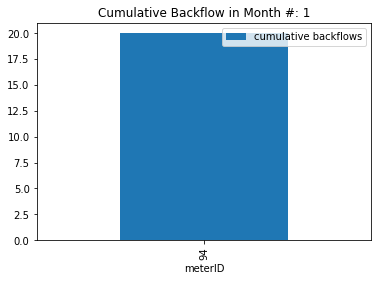

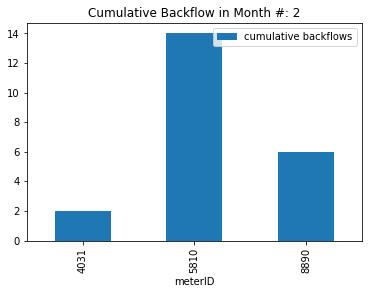

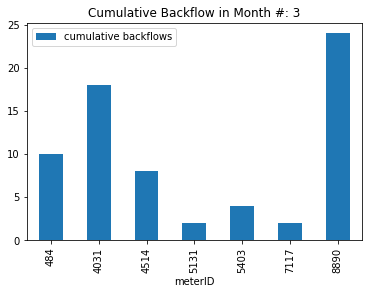

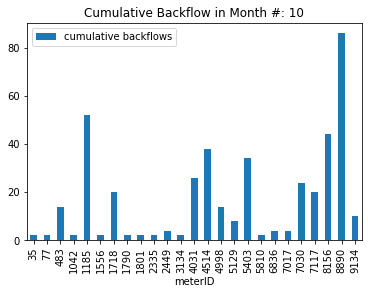

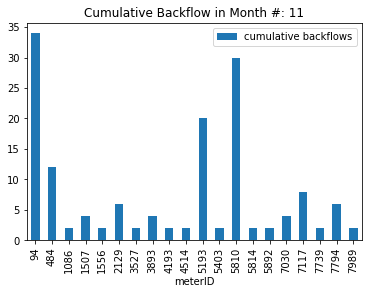

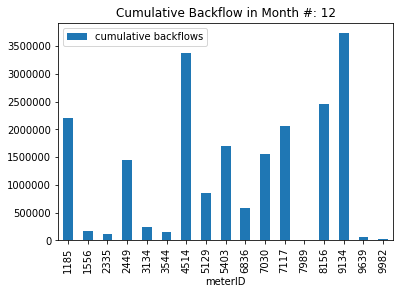

In [37]:
for month in cumbf_df['month'].unique():
    cumbf_df[cumbf_df['month'] == month].plot.bar(x='meterID',y='cumulative backflows',title='Cumulative Backflow in Month #: '+str(month))

From the cumulative bar plot, even without setting any threshold on cumulative backflow magntiude, we can see here again that in the month of December, not only does it has the highest frequency, it has extremely large magnitude of erroneous backflow readings (its magnitude is 10^5 times the other 5 months). This agrees with our initial guess that there could be an event which causes a major fault to many meters in December. Hence, it is intuitive that we should prioritize on investigating the meters affected in this month, and evaluate whether or not they are worth enough to spend resources for repair.

#### Economic Analysis
After concluding that we should prioritize investigation on the meters that are faulty in December, we need to perform some economic analysis to determine whether a meter is worth repairing from economic standpoint. In this section, we would perform such analysis, by taking the price and calculating the shortcomings and possible losses of overlooking the meters. In this way, utilities would also be better informed on how to efficiently allocate manpower and to make better profiting business decisions.

According to online sources [https://www.eia.gov/dnav/ng/hist/n3020us3m.htm], the cost of gas in commercial pricing is $7.74 / 1000 cubic feet. Only the month of December will be essential for repair of the meters as the cumulative backflow magnitude is large enough. This is done in the code section below

In [38]:
cost_df = pd.DataFrame(columns = ['meterID', 'monetary loss'])
for month, meterID, cumulative_backflow in cumbf_df[cumbf_df['month'] == 12].values:
    temp = pd.DataFrame({'meterID': [meterID],
                         'monetary loss':[cumulative_backflow*7.74/1000]})
    
    cost_df = cost_df.append(temp)

cost_df.reset_index(drop = True, inplace = True)
print(cost_df)

   meterID  monetary loss
0     1185    16997.69016
1     1556     1260.72216
2     2335      887.83992
3     2449    11137.64328
4     3134     1794.03912
5     3544     1182.57912
6     4514    26161.02972
7     5129     6539.29380
8     5403    13157.61300
9     6836     4498.89048
10    7030    11993.25384
11    7117    16002.66672
12    7989        0.38700
13    8156    19004.09940
14    9134    28873.88424
15    9639      454.74048
16    9982      217.27728


Assuming that the typical running cost of repair maintenance would be around $150, then intuitively we must repair meters that when overlooked, would incur costs more than this amount. By applying these comparison, the following meters should the utilities provider's priority to fix.

In [39]:
cost_df[cost_df['monetary loss'] > 150]

,meterID,monetary loss
0,1185,16997.69016
1,1556,1260.72216
2,2335,887.83992
3,2449,11137.64328
4,3134,1794.03912
5,3544,1182.57912
6,4514,26161.02972
7,5129,6539.29380
8,5403,13157.61300
9,6836,4498.89048


In conclusion, by a simple analysis on cumulative backflows and weighing economic factors like costs and monetary losses, we can determine the meters which demands the highest priority of investigation and repairs. Moreover, the above economic analysis could also be extended to other meters in other months, to estimate the amount of losses incurred.

### Proposal 2: Reporting Frequency

In this section, we will investigate our claim regarding the reporting behaviour of the meter. As stated in the project document,"The meters report a reading (in terms of the cumulative consumption) when the last marginal 2 cubic foot (or higher) of natural gas passes through the meter". However, as seen from Section 1, this is not the case. There are many meters that report even when the cumulative consumption doesn't change, and the frequency of such reports are also relatively high in proportion. Furthermore, as elaborated in Section 1, considering meters who have such behaviour is faulty is unreasonable, since this would result in majority of the meters involved in the study to be classified as faulty. Hence we came up with a hypothesis, that besides following the 'rule' stated above, the meters also follow a secondary rule, that is it will report under some base frequency. Hence, even when the readings don't change, they will still report, which thus explains the observations in Section 1. We feel this is a reasonable hypothesis, because intuitively, even when there are no change in cumulative reading, it makes sense to report so as to show the data gathering center that the meter is still operational. This section attempts to find whether such base reporting frequency or period exists.

Our methodology for this analysis is as follows:
- For each meter, we would find the time interval in seconds, between 2 consecutive readings where the value don't change. Then we count the number of occurrences of each time interval for the same meter
- Then, we plot the 'scatter' plot of the time interval vs their number of occurrences. We would then look for the peak that occur at the lowest time interval. This would be the base reporting period. We will explain in greater detail in the results analysis later about why this is so.

Find number of unique IDs

In [40]:
df_id = df.loc[:,'dataid']
df_id.nunique()

157

We create a copy of the original dataframe and do the necessary manipulations on the 'localminute' column, so that the timezones in the timestamps are disregarded. This is because the timezones found in the timestamps were determined and explained previously to be meaningless. Additionally, we sort the dataframe by the meter ID and localminute.

In [41]:
df2 = df.copy()
df2['localminute'] = df2['localminute'].astype(str).str[:-3]
df2["localminute"] = pd.to_datetime(df2.localminute)
df2 = df2.sort_values(by=['dataid','localminute'])
print(df2.head(20))
print(df2.tail(20))

             localminute  dataid  meter_value
83   2015-10-01 00:14:44      35        93470
244  2015-10-01 00:42:34      35        93470
723  2015-10-01 02:02:37      35        93470
790  2015-10-01 02:12:38      35        93470
829  2015-10-01 02:20:36      35        93470
852  2015-10-01 02:23:39      35        93470
1418 2015-10-01 03:59:41      35        93470
1588 2015-10-01 04:30:40      35        93470
1615 2015-10-01 04:34:37      35        93470
1842 2015-10-01 05:14:35      35        93470
1855 2015-10-01 05:17:32      35        93470
2246 2015-10-01 06:23:36      35        93472
2618 2015-10-01 07:26:51      35        93472
2881 2015-10-01 08:19:40      35        93472
3035 2015-10-01 08:44:40      35        93472
3091 2015-10-01 08:54:30      35        93472
3318 2015-10-01 09:36:34      35        93472
3981 2015-10-01 11:24:52      35        93474
4360 2015-10-01 12:29:40      35        93474
5259 2015-10-01 15:04:40      35        93474
                    localminute  d

We then group by the meter ID and meter values (so that each group is of the same meters with the same value).

In [42]:
test_df = df2.groupby(['dataid', 'meter_value'])

In [43]:
test_df.groups

{(35,
  93470): Int64Index([83, 244, 723, 790, 829, 852, 1418, 1588, 1615, 1842, 1855], dtype='int64'),
 (35, 93472): Int64Index([2246, 2618, 2881, 3035, 3091, 3318], dtype='int64'),
 (35, 93474): Int64Index([3981, 4360, 5259, 5348, 5711], dtype='int64'),
 (35, 93476): Int64Index([5946, 5985, 6055, 6224, 6269, 6588], dtype='int64'),
 (35, 93482): Int64Index([6843, 6923], dtype='int64'),
 (35,
  93484): Int64Index([7386, 7400, 7482, 7623, 7832, 8017, 8308, 8336, 8754, 8819, 9113], dtype='int64'),
 (35,
  93486): Int64Index([9568, 9670, 9861, 10327, 10486, 10508, 10813], dtype='int64'),
 (35,
  93488): Int64Index([11433, 11496, 11712, 11885, 12025, 12281, 12405, 12455, 13012], dtype='int64'),
 (35, 93490): Int64Index([13425, 13759, 13827], dtype='int64'),
 (35, 93508): Int64Index([14872], dtype='int64'),
 (35, 93510): Int64Index([15227], dtype='int64'),
 (35, 93516): Int64Index([15481], dtype='int64'),
 (35, 93520): Int64Index([15697], dtype='int64'),
 (35,
  93522): Int64Index([15908, 1

In [44]:
test_df.get_group((35, 93470))

,localminute,dataid,meter_value
83,2015-10-01 00:14:44,35,93470
244,2015-10-01 00:42:34,35,93470
723,2015-10-01 02:02:37,35,93470
790,2015-10-01 02:12:38,35,93470
829,2015-10-01 02:20:36,35,93470
852,2015-10-01 02:23:39,35,93470
1418,2015-10-01 03:59:41,35,93470
1588,2015-10-01 04:30:40,35,93470
1615,2015-10-01 04:34:37,35,93470
1842,2015-10-01 05:14:35,35,93470


We take the time difference between reports. This gives us the time differences between reports despite unchanged meter values. All time differences are in seconds. Essentially, this gives us the intervals between meter values where the values remain unchanged.

In [45]:
df_lst = []

for x in tqdm(test_df.groups, position=0):
    temp_diff = (test_df.get_group(x)['localminute'].diff().dropna()) / np.timedelta64(1, 's')
    for y in temp_diff:
        df_lst.append([x[0], int(y)])

df3 = pd.DataFrame(data=df_lst, columns=['dataid', 'TimeDifference'])

print(df3.head(20))
print(df3.tail(20))

100%|████████████████████████████████████████████████████████████████████████| 325621/325621 [05:16<00:00, 1027.60it/s]


    dataid  TimeDifference
0       35            1670
1       35            4803
2       35             601
3       35             478
4       35             183
5       35            5762
6       35            1859
7       35             237
8       35            2398
9       35             177
10      35            3795
11      35            3169
12      35            1500
13      35             590
14      35            2524
15      35            3888
16      35            9300
17      35             961
18      35            3722
19      35             474
         dataid  TimeDifference
1259182    9982            1495
1259183    9982            2148
1259184    9982            4037
1259185    9982            3596
1259186    9982            4517
1259187    9982            5377
1259188    9982            2344
1259189    9982            1557
1259190    9982            4939
1259191    9982            9013
1259192    9982            8535
1259193    9982            7624
1259194    9982  

We will find the number of occurrences of time intervals in each meter and plot them out in a scatter plot as shown below.

100%|████████████████████████████████████████████████████████████████████████████████| 155/155 [00:01<00:00, 96.59it/s]


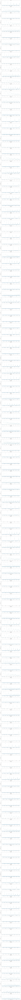

In [46]:
fig, ax = plt.subplots(df3['dataid'].nunique(), 1, figsize=(15, 5*df3['dataid'].nunique()))
plt.subplots_adjust(hspace=0.3)
timediff = df3.groupby(by='dataid')

for idx, meter_name in enumerate(tqdm(timediff.groups, position=0)):
    curr_meter_diff = timediff.get_group(meter_name).TimeDifference.values
    time1 = [0]*(max(curr_meter_diff) + 1)
    for diff in curr_meter_diff:
        time1[diff] += 1
    prctile = 25                # adjust percentile value here
    x_lb = max([0, min(curr_meter_diff)-10])
    x_ub = min([max(curr_meter_diff)+1, int(np.percentile(curr_meter_diff, prctile))+10])
    ax[idx].scatter([x for x in range(x_lb, x_ub)], time1[x_lb:x_ub], marker='.')
    ax[idx].set_title('Meter ' + str(meter_name))
    ax[idx].set_xlabel('Reporting interval')
    ax[idx].set_ylabel('Frequency')

From the scatter plot above, we can make the following observations
-  We see that every meter have different 'first peak' (i.e. the peak that occur at the least time interval), which suggests that each meter follows a different reporting period. Although there are some meters that have similar first peak, e.g. meter 35 and 77 first peak occurs at around 60 seconds.
- A peak in the scatter plot refers to a time interval that occurs with relatively high number of occurrences (i.e. the meters report at this time interval even when there are no change in readings). Notice from the plots that there are multiple peaks, which are spaced out in somewhat periodic fashion.
- Even though peaks at a larger time interval could have higher occurrences, this could not be the base reporting time interval. This is because, if we choose the smaller peak to be the base time interval, then intuitively these larger peaks at higher time interval could be explained. Since the larger peaks occur at somewhat periodic intervals of the first peak, then this might be because the meter actually reports at the base interval, but at that instance, the data transmission fails and the packet is loss. Hence, it would wait until the next period to transmit, and hence at the receiver side, the reporting interval is detected to be twice (or integer multiples) of the base interval. E.g. meter 871, the first peak occurs at a reporting interval of 15 seconds. Then the next peak can be observed to occur at a reporting interval of 30 seconds, 45 seconds, 60 seconds,75 seconds, 90 seconds, etc (i.e. multiples of 15). Although the number of occurrences of reporting interval of 30 seconds is higher, the base frequency would still be 15 seconds, and that the 30 seconds interval occur because when the meter reports at the 15 seconds interval, the packet gets lost. Hence it waits another 15 seconds, and retransmits and is successful. At the receiver side, the interval is thus detected as 30 seconds. It is quite obvious from this perspective that if we have taken the peak at a larger time interval instead, then the peak at the smaller interval could not be explained. Hence, we can conclude that the base reporting interval is the time interval at which the first peak occurs (and subsequent peaks could be attributed to failed transmission at first period and thus retransmissions at subsequent periods). Another example: Meter 661, the first peak occurs around 60 seconds. Notice from the plot, that subsequent peaks occur at 120 seconds, 180 seconds, 240 seconds, 300 seconds, etc. Hence 60 seconds is the base reporting interval
- We also notice that the time intervals around the peaks also have a high frequency. E.g. for meter 2945, first peak is around 60 seconds, but at 58 or 59 or 61 seconds, it also high. This slight deviation may be attributed to random errors/slight delays in transmission; we say that the base interval is 60 seconds, but it could have transmitted at 58 or 59 or 61 seconds (i.e. some uncertainties/random errors). The same reasoning applies to the subsequent peaks.
- Finally, note that some meters like meter 2946 have only a single peak with a frequency/number of occurrence of 1. This indicates that this meter only reports unchanged value once in the month we are studying. In such cases, we **cannot** conclude that this is the base reporting interval, because we only have 1 data. This might be because we are only studying one month. Hence the method proposed above is just a proof of concept; we could extend this to include all months and apply the same reasoning to deduce the base reporting interval. Also, peaks at 0 should be ignored (since reporting interval cannot be 0)

Hence from the above anaylsis, we can conclude that our hypothesis is proven; the meters does indeed follow a base reporting interval. The base reporting interval however, is not common for all meters (although there are some meters with common base reporting interval). 

### Proposal 3: Future gas consumption prediction with correlation grouping

From Section 2.2, we have seen that one problem of following the first framework was that it relies heavily on prior data. This can somewhat be solved by using the second framework, though at the cost of noticeably worse accuracy. Another problem of the first framework, is that the process of looking for the best parameters n (and p for linear regression) also takes quite long, because at each step, we are essentially retraining based on n prior hours (with that value of p for linear regression). In this section, we would try to reduce the number of times we need to search for these parameters, by not searching for every meter.

To do so, we make use of our findings from Section 1.3, which is the correlation coefficient. Our intuition is that if certain meters have a consumption pattern that are highly correlated (and thus having a cumulative meter reading that are also highly correlated, because consumption is just step difference of cumulative reading), then these meters would follow the same trend (which thus means the would likely be predictable/fitted by the same polynomial order and needs the same number of prior hours). Hence our methodology is as follows:
- Set a certain threshold for the correlation coefficient (e.g. 0.5). Find the meter who is correlated to the most number of meter (correlated defined as having a correlation coefficient greater than or equal to the above threshold).
- Perform the search for the best n and p value (we apply both linear regression and SVR here following the first framework in Section 2.2) for this meter
- Then, use the found n and p values to train models and make batch predictions for this meter and all the meters correlated to it. For SVR, only n value is used (we have no p values)

This is done in the code section below

In [47]:
corr = hourly_aggregation_month.corr()

adj_lst = dict()
popularity_lst = []

for i in id_label:
    lst = []
    for j in id_label:
        if i == j:
            continue
        if corr[i][j] >= 0.5:
            lst.append(j)
    adj_lst[i] = lst
    popularity_lst.append((len(lst), i))
    
popularity_lst.sort(reverse=True)
popularity_lst

[(50, 4514),
 (46, 5439),
 (45, 3577),
 (43, 4356),
 (40, 9729),
 (38, 3918),
 (37, 9639),
 (36, 5395),
 (34, 9631),
 (33, 7739),
 (33, 7017),
 (33, 3367),
 (33, 2470),
 (32, 5636),
 (31, 2980),
 (30, 3544),
 (29, 3527),
 (29, 2094),
 (29, 661),
 (28, 7682),
 (28, 6830),
 (27, 8386),
 (27, 7794),
 (25, 3310),
 (23, 1507),
 (22, 7674),
 (22, 1556),
 (22, 871),
 (21, 3134),
 (20, 8703),
 (19, 8890),
 (19, 4373),
 (19, 1619),
 (18, 8829),
 (17, 9121),
 (16, 4767),
 (15, 2378),
 (15, 2018),
 (14, 744),
 (13, 4031),
 (12, 1086),
 (11, 5785),
 (10, 7989),
 (10, 5484),
 (10, 2072),
 (9, 1801),
 (8, 8086),
 (8, 7566),
 (8, 5972),
 (8, 4998),
 (8, 4732),
 (8, 4228),
 (8, 2946),
 (7, 9600),
 (7, 9160),
 (7, 9134),
 (7, 4296),
 (7, 2755),
 (7, 1791),
 (7, 1103),
 (6, 8244),
 (6, 3036),
 (6, 2814),
 (6, 2645),
 (5, 7429),
 (4, 9982),
 (4, 9620),
 (4, 4671),
 (4, 1792),
 (4, 1714),
 (3, 6685),
 (3, 6101),
 (3, 5545),
 (3, 2575),
 (3, 1718),
 (3, 1042),
 (3, 187),
 (3, 114),
 (2, 9956),
 (2, 9766),


In [48]:
cc_lst = []
visited = dict()

for i in id_label:
    visited[i] = 0
    
for i, meterid in popularity_lst:
    cc = []
    q = deque()
    q.append(meterid)
    
    while len(q):
        curr = q.popleft()
        if visited[curr]:
            continue
        visited[curr] = 1
        cc.append(curr)
        for neighbour in adj_lst[curr]:
            if visited[neighbour]:
                continue
            q.append(neighbour)
            
    if len(cc):
        cc_lst.append(cc)

In [49]:
cc_lst

[[4514,
  2018,
  7989,
  3527,
  4998,
  1507,
  8386,
  7017,
  7794,
  2094,
  871,
  5636,
  7674,
  4031,
  3918,
  1086,
  3134,
  8829,
  4732,
  7739,
  2072,
  3577,
  9639,
  7429,
  744,
  8086,
  1556,
  7682,
  1791,
  5785,
  9729,
  4767,
  5439,
  4356,
  3367,
  5395,
  9121,
  3310,
  3544,
  4228,
  1619,
  6830,
  2980,
  5972,
  661,
  5484,
  9631,
  2470,
  4373,
  1103,
  8703,
  1801,
  9134,
  9982,
  8890,
  2378,
  187,
  4296,
  9766,
  114,
  1718,
  8084,
  7741,
  1792,
  1714,
  2129,
  1042,
  2575,
  739,
  3723,
  2461,
  4193,
  2449,
  5193,
  9052],
 [7566, 3036, 9160, 8244, 2755, 9600, 2946, 2814, 6101],
 [2645, 9956, 6578, 9620, 5545, 4671, 6685, 6863, 3039, 2233],
 [9849],
 [9295],
 [9278],
 [8967],
 [8156],
 [8155],
 [8059],
 [7965],
 [7900],
 [7287],
 [7117],
 [7030],
 [7016],
 [6910],
 [6836],
 [6673],
 [6505],
 [6412],
 [5892],
 [5814],
 [5810],
 [5658],
 [5403],
 [5317],
 [5275],
 [5131],
 [5129],
 [4029],
 [3893],
 [3849],
 [3778],
 [3635

In [50]:
ridge = lm.RidgeCV()
np_dict = dict() # key is meter_id, value is tuple in the form of (n,p)
for cc in tqdm(cc_lst, position=0):
    if len(cc) == 1:
        continue
    curr_hourly_month_meter = hourly_aggregation_month_total[cc[0]]
    N_dict = dict()
    # looking for the optimal value of N between 2 hrs and 24 hrs
    for N in range(2,25):
        mse_arr = [0]*3
        num_models = 200 # The number of models to create to find the average MSE
        for i in range(num_models):
            time_train = [x for x in range(i, i+N)]
            meter_train = curr_hourly_month_meter[i:i+N]
            meter_true = curr_hourly_month_meter[i+N]
            for p in range(1, 4):
                ridge.fit(np.vander(time_train, p+1), meter_train)
                meter_pred = ridge.predict(np.vander([i+N], p+1))
                mse = abs(meter_true-meter_pred)**2
                mse_arr[p-1] += mse
        mse_arr = [x/num_models for x in mse_arr]
        min_mse = min(mse_arr)
        min_p = mse_arr.index(min_mse) + 1
        N_dict[N] = (min_mse, min_p)
    min_n = min(N_dict, key=N_dict.get)
    for i in cc:
        np_dict[i] = (min_n, N_dict[min_n][1])

100%|██████████████████████████████████████████████████████████████████████████████████| 57/57 [00:25<00:00,  2.20it/s]


In [51]:
np_dict

{4514: (2, 2),
 2018: (2, 2),
 7989: (2, 2),
 3527: (2, 2),
 4998: (2, 2),
 1507: (2, 2),
 8386: (2, 2),
 7017: (2, 2),
 7794: (2, 2),
 2094: (2, 2),
 871: (2, 2),
 5636: (2, 2),
 7674: (2, 2),
 4031: (2, 2),
 3918: (2, 2),
 1086: (2, 2),
 3134: (2, 2),
 8829: (2, 2),
 4732: (2, 2),
 7739: (2, 2),
 2072: (2, 2),
 3577: (2, 2),
 9639: (2, 2),
 7429: (2, 2),
 744: (2, 2),
 8086: (2, 2),
 1556: (2, 2),
 7682: (2, 2),
 1791: (2, 2),
 5785: (2, 2),
 9729: (2, 2),
 4767: (2, 2),
 5439: (2, 2),
 4356: (2, 2),
 3367: (2, 2),
 5395: (2, 2),
 9121: (2, 2),
 3310: (2, 2),
 3544: (2, 2),
 4228: (2, 2),
 1619: (2, 2),
 6830: (2, 2),
 2980: (2, 2),
 5972: (2, 2),
 661: (2, 2),
 5484: (2, 2),
 9631: (2, 2),
 2470: (2, 2),
 4373: (2, 2),
 1103: (2, 2),
 8703: (2, 2),
 1801: (2, 2),
 9134: (2, 2),
 9982: (2, 2),
 8890: (2, 2),
 2378: (2, 2),
 187: (2, 2),
 4296: (2, 2),
 9766: (2, 2),
 114: (2, 2),
 1718: (2, 2),
 8084: (2, 2),
 7741: (2, 2),
 1792: (2, 2),
 1714: (2, 2),
 2129: (2, 2),
 1042: (2, 2),


The above prints are the polynomial order and the n values found for the central meter and the correlated meters who follows this value (for n and p). Note that there are more than 1 group of correlated meters, hence we would expect to see more than 1 set of n and p values (there are 3 sets, i.e. n=2, p=2, n=2, p=1, and n=24,p=1)

100%|██████████████████████████████████████████████████████████████████████████████████| 94/94 [00:50<00:00,  1.82it/s]


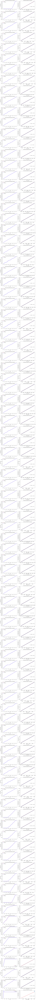

In [52]:
fig,ax = plt.subplots(len(np_dict),2, figsize=(15,5*len(np_dict)))
plt.subplots_adjust(hspace = 0.3)
for idx, entry in enumerate(tqdm(np_dict.items(), position=0)):
    curr_hourly_month_meter = hourly_aggregation_month_total[meter_id]
    length = len(curr_hourly_month_meter)
    meter_id, np_tuple = entry
    N = np_tuple[0]
    p = np_tuple[1]
    time_plot = [x for x in range(N, length)]
    meter_true = curr_hourly_month_meter[N:length]
    meter_pred = []
    for i in range(length-N):
        time_train = [x for x in range(i, i+N)]
        meter_train = curr_hourly_month_meter[i:i+N]
        ridge.fit(np.vander(time_train, p+1), meter_train)
        meter_pred.append(ridge.predict(np.vander([i+N], p+1)))
    ax[idx][0].set_title('Time series plot of Meter ' + str(meter_id) + ' in January')
    ax[idx][0].plot(time_plot, meter_true, 'r-', label='true')
    ax[idx][0].plot(time_plot, meter_pred, 'b-', label='predicted')
    ax[idx][0].legend()
    ax[idx][0].set_xlabel('Time')
    ax[idx][0].set_ylabel('Meter reading')
    ax[idx][1].set_title('Scatter plot of Meter ' + str(meter_id) + ' in January')
    ax[idx][1].scatter(meter_true, meter_pred, marker='.')
    ax[idx][1].set_xlabel('Actual reading')
    ax[idx][1].set_ylabel('Predicted reading')
    m, c = np.polyfit(meter_true, meter_pred, 1)
    ax[idx][1].plot(meter_true, meter_true, 'r-')
    try:
        ax[idx][1].text(0.8, 0.3, 'y = '+str(round(m[0], 5))+'x + '+ str(round(c[0], 5)), horizontalalignment='center', verticalalignment='center', transform=ax[idx][1].transAxes)
    except:
        ax[idx][1].text(0.8, 0.3, 'y = '+str(round(m, 5))+'x + '+ str(round(c, 5)), horizontalalignment='center', verticalalignment='center', transform=ax[idx][1].transAxes)

The above plots show the linear regression following the first framework of Section 2.2, by using correlation coefficient to find a uniform n and p values for correlated meters. As seen from the right hand side plots, most of the results seem quite satisfactory; the difference from the actual values are still very small just like in Section 2.2. However, the prediction for some meters became worse; e.g. Meter 2233, the errors at the higher readings are large as seen from the right hand side plot (it deviates quite far from y=x line, which is the red line). This is because, as seen from the n and p values printed before, meter 2233 uses a p value = 1. However, seeing from the left plot, it is clear that to predict such abrupt changing (sharp) curve (shown in red), we would need a higher polynomial order. But due to correlation, it follows the p value of the group's center meter (the one who is correlated to all others in this group), and hence the model slightly underfits. All in all, the results are still quite satisfactory while at the same time cutting down the processing time significantly

In [53]:
np_dict_svr = dict() # key is meter_id, value is N
svr = SVR(kernel='rbf', gamma='scale')
for cc in tqdm(cc_lst, position=0):
    if len(cc) == 1:
        continue
    curr_hourly_month_meter = hourly_aggregation_month_total[cc[0]]
    N_dict = dict()
    # looking for the optimal value of N between 2 hrs and 24 hrs
    for N in range(2,25):
        mse = 0
        num_models = 200 # The number of models to create to find the average MSE
        for i in range(num_models):
            time_train = [[x] for x in range(i, i+N)]
            meter_train = curr_hourly_month_meter[i:i+N]
            meter_true = curr_hourly_month_meter[i+N]
            svr.fit(time_train, meter_train)
            meter_pred = svr.predict([[i+N]])
            mse += abs(meter_true-meter_pred)**2
        N_dict[N] = mse/num_models
    min_n = min(N_dict, key=N_dict.get)
    for i in cc:
        np_dict_svr[i] = min_n

100%|██████████████████████████████████████████████████████████████████████████████████| 57/57 [00:06<00:00,  9.02it/s]


In [54]:
np_dict_svr

{4514: 2,
 2018: 2,
 7989: 2,
 3527: 2,
 4998: 2,
 1507: 2,
 8386: 2,
 7017: 2,
 7794: 2,
 2094: 2,
 871: 2,
 5636: 2,
 7674: 2,
 4031: 2,
 3918: 2,
 1086: 2,
 3134: 2,
 8829: 2,
 4732: 2,
 7739: 2,
 2072: 2,
 3577: 2,
 9639: 2,
 7429: 2,
 744: 2,
 8086: 2,
 1556: 2,
 7682: 2,
 1791: 2,
 5785: 2,
 9729: 2,
 4767: 2,
 5439: 2,
 4356: 2,
 3367: 2,
 5395: 2,
 9121: 2,
 3310: 2,
 3544: 2,
 4228: 2,
 1619: 2,
 6830: 2,
 2980: 2,
 5972: 2,
 661: 2,
 5484: 2,
 9631: 2,
 2470: 2,
 4373: 2,
 1103: 2,
 8703: 2,
 1801: 2,
 9134: 2,
 9982: 2,
 8890: 2,
 2378: 2,
 187: 2,
 4296: 2,
 9766: 2,
 114: 2,
 1718: 2,
 8084: 2,
 7741: 2,
 1792: 2,
 1714: 2,
 2129: 2,
 1042: 2,
 2575: 2,
 739: 2,
 3723: 2,
 2461: 2,
 4193: 2,
 2449: 2,
 5193: 2,
 9052: 2,
 7566: 2,
 3036: 2,
 9160: 2,
 8244: 2,
 2755: 2,
 9600: 2,
 2946: 2,
 2814: 2,
 6101: 2,
 2645: 2,
 9956: 2,
 6578: 2,
 9620: 2,
 5545: 2,
 4671: 2,
 6685: 2,
 6863: 2,
 3039: 2,
 2233: 2}

100%|██████████████████████████████████████████████████████████████████████████████████| 94/94 [00:35<00:00,  2.56it/s]


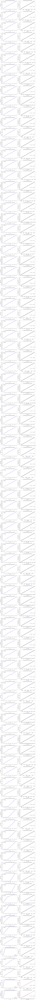

In [55]:
fig,ax = plt.subplots(len(np_dict_svr),2, figsize=(15,5*len(np_dict_svr)))
plt.subplots_adjust(hspace = 0.3)
for idx, entry in enumerate(tqdm(np_dict_svr.items(), position=0)): # Originally to be np_dict_svr
    meter_id, N = entry
    curr_hourly_month_meter = hourly_aggregation_month_total[meter_id]
    length = len(curr_hourly_month_meter)
    time_plot = [x for x in range(N, length)]
    meter_pred = []
    meter_true = curr_hourly_month_meter[N:length]
    for i in range(length-N):
        time_train = [[x] for x in range(i, i+N)]
        meter_train = curr_hourly_month_meter[i:i+N]
        svr.fit(time_train, meter_train)
        meter_pred.append(svr.predict([[i+N]]))
    ax[idx][0].set_title('Time series plot of Meter ' + str(meter_id) + ' in January')
    ax[idx][0].plot(time_plot, meter_true, 'r-', label='true')
    ax[idx][0].plot(time_plot, meter_pred, 'b-', label='predicted')
    ax[idx][0].legend()
    ax[idx][0].set_xlabel('Time')
    ax[idx][0].set_ylabel('Meter reading')
    ax[idx][1].set_title('Scatter plot of Meter ' + str(meter_id) + ' in January')
    ax[idx][1].scatter(meter_true, meter_pred, marker='.')
    ax[idx][1].set_xlabel('Actual reading')
    ax[idx][1].set_ylabel('Predicted reading')
    m, c = np.polyfit(meter_true, meter_pred, 1)
    ax[idx][1].plot(meter_true, meter_true, 'r-')
    try:
        ax[idx][1].text(0.8, 0.3, 'y = '+str(round(m[0], 5))+'x + '+ str(round(c[0], 5)), horizontalalignment='center', verticalalignment='center', transform=ax[idx][1].transAxes)
    except:
        ax[idx][1].text(0.8, 0.3, 'y = '+str(round(m, 5))+'x + '+ str(round(c, 5)), horizontalalignment='center', verticalalignment='center', transform=ax[idx][1].transAxes)

The above is the results of applying the correlation based predictions using SVR. As seen from the printed dictionary in the cell before, the n values are all 2. In the SVR case, the quality of prediction using correlation is not noticeably worse than the case in Section 2.2. For e.g. Meter 2233, whose predictions was worse in the linear regression with correlation case; in the SVR case, the right hand scatter plot is more or less of the same quality as the case in Section 2.2. There are no points that are significantly further from the y=x line in this plot vs the plot in Section 2.2. This is because, in SVR case, we are using RBF kernel, and there are no other parameter that we modify except n. Hence, in a way, the model complexity in this case is roughly the same as the model complexity in Section 2.2, which thus results in similar quality of prediction (in fact it is the same results, because as seen from the list of n values found, they are all 2, which is also the case in Section 2.2).

One thing to note with this method though, is that by taking central meters and the corresponding correlated meters, we will leave out several meters, that would be singeltons (i.e. they are not correlated to any other meters, which means their correlation coefficient is less than our threshold). In the above method, we have left out these singletons, because we intend to show a proof of concept as to how our method can be carried out. To work around these singletons, we can consider more data (in the above method, we only considered 1 month which is January, but we could have considered the cumulative readings and hourly gas consumption for all 6 months). Then we re-evalute the correlation for these singletons, and see whether they are correlated with any other meters. If they remain singletons, then we would have to resort to finding best n (and p for linear regression) values for these meters individually.

Hence we can conclude that our proposal to improve the efficiency of prediction in Section 2.2 works, with satisfactory results. Note that these predictions can be extended to the same real-life uses as the ones stated in Section 2.1, i.e. to predict daily consumption trends, or to predict gas consumption at specific times, etc.

### Proposal 4: Clustering meter IDs to identify similarities in gas consumption

In this section, our goal is to identify consumption similarities between the meters. This is to identify and possibly classify the meters into 3 respective household types, namely single-family homes, apartments, and town homes. The rationale behind this analysis is to provide insight to the utilities provider regarding the nature of each household's consumption. This can help with classifying future new households under one of the single-family home, apartment or town home category, so as to give the utilities provider a better understanding of the consumption of a future new household such that they can speculate consumer's level of gas consumption to have preemptive control over gas supplies in response to the demand. 

Furthermore, as stated here [https://ieeexplore.ieee.org/document/6965659], being able to classify the households provides insights to power distribution and generation companies  regarding their customer's load profile which in turn allows efficient planning of electricity distribution networks, optimising production capacity, as well as deployment of smart-grid enabling technologies.

We will be using sequential hour readings, which is 744 hours of a month, as obtained in earlier parts. In addition, we will also be aggregating the 24 hour readings of the months. Essentially, the values corresponding to 0th hour up till 23th hour is aggregated to form our alt_hourly_aggregation_month dataframe as seen below. We use this two representations of data so that we can see if there are any disparities between the clustering results when the features of the data points were to be represented different.

In [56]:
alt_hourly_aggregation_month = [[0]*len(id_label)]*24
alt_hourly_aggregation_month = pd.DataFrame(alt_hourly_aggregation_month, columns=id_label)
for meterid in tqdm(hourly_aggregation_month.columns):
    curr_meters = hourly_aggregation_month[meterid].values
    for i in range(24):
        for j in range(31):
            alt_hourly_aggregation_month[meterid][i] += curr_meters[i + j*24]
        alt_hourly_aggregation_month[meterid][i] //= 31

100%|████████████████████████████████████████████████████████████████████████████████| 148/148 [00:08<00:00, 18.18it/s]


The clustering algorithm used is K means, where K is set to 3 to represent the 3 groups of household types. The assumption made in this case is that all three household groups are of similar size and densities. K means will first instantiate 3 random centroids, whereby each data point with the nearest distance will be associated with the nearest cluster centroid. The centroids coordinates will be recalculated by taking the center of all the data points that are associated with its cluster. This process will repeat iteratively until the three centroid coordinates converges. Since there are 744 features, the distance metric will be of the 74th order.

For visualisation purposes, PCA is performed on the resulting clusters to visualise the clustering results. The 3D and 2D feature space with the highest variance are displayed as follows:

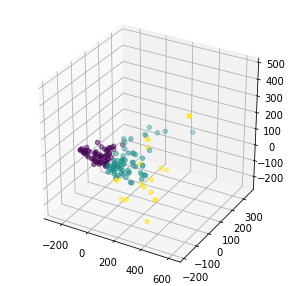

In [57]:
np_array = np.transpose(np.array(hourly_aggregation_month))
kmeans = KMeans(n_clusters=3, random_state= 0)
kmeans.fit(np_array)
y_kmeans_744 = kmeans.predict(np_array)
pca = decomposition.PCA(n_components=3)
pca.fit(np_array)
np_array_pca = pca.transform(np_array)
fig = plt.figure(figsize = (5,5))
ax = plt.axes(projection='3d')
ax.scatter3D(np_array_pca[:, 0], np_array_pca[:, 1], np_array_pca[:, 2], c=y_kmeans_744, cmap='viridis');

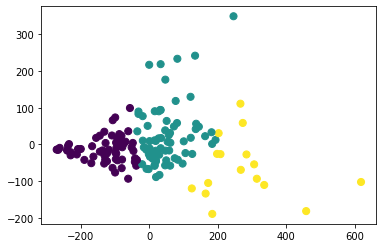

In [58]:
pca = decomposition.PCA(n_components=2)
pca.fit(np_array)
np_array_pca = pca.transform(np_array)
plt.scatter(np_array_pca[:, 0], np_array_pca[:, 1], c=y_kmeans_744, s=50, cmap='viridis')

Here is the same K means clustering performed on the 24 hours aggregated data. The distance metric would be of the 24th order instead of the 744th. The same PCA visualisation will performed to illustrate the cluster groups. The 2 and 3 dimensions with the highest variance, out of the 24 dimensions will be selected as the display feature space.

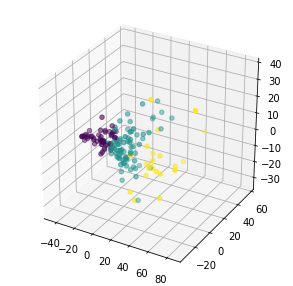

In [59]:
np_array_alt = np.transpose(np.array(alt_hourly_aggregation_month))
kmeans = KMeans(n_clusters=3, random_state= 0)
kmeans.fit(np_array_alt)
y_kmeans_24 = kmeans.predict(np_array_alt)
pca = decomposition.PCA(n_components=3)
pca.fit(np_array_alt)
np_array_alt_pca = pca.transform(np_array_alt)
fig = plt.figure(figsize = (5,5))
ax = plt.axes(projection='3d')
ax.scatter3D(np_array_alt_pca[:, 0], np_array_alt_pca[:, 1], np_array_alt_pca[:, 2], c=y_kmeans_24, cmap='viridis');

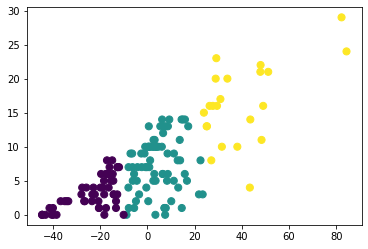

In [60]:
pca = decomposition.PCA(n_components=2)
pca.fit(np_array_alt)
np_array_alt_pca = pca.transform(np_array_alt)
plt.scatter(np_array_alt_pca[:, 0], np_array_alt[:, 1], c=y_kmeans_24, s=50, cmap='viridis')

There seem to be slight differences in the feature space plotted, which can be contributed by the difference in variance for the 744 hours and 24 hours aggregated data. In order to see the cluster groups that each meter is associated with, we assess the direct cluster group ID for each meters.

In [61]:
y_kmeans_744

array([2, 0, 1, 0, 1, 1, 1, 0, 1, 2, 0, 1, 0, 1, 0, 0, 2, 2, 2, 1, 0, 1,
       1, 1, 0, 1, 1, 1, 1, 2, 0, 1, 1, 2, 1, 1, 0, 1, 0, 2, 0, 1, 1, 1,
       1, 2, 0, 1, 1, 0, 1, 1, 1, 1, 0, 2, 1, 1, 1, 0, 1, 0, 0, 1, 2, 1,
       0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 2, 2, 1, 0, 2, 1,
       0, 1, 1, 2, 0, 1, 1, 1, 1, 2, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [62]:
y_kmeans_24

array([2, 1, 2, 1, 1, 1, 2, 0, 1, 2, 0, 2, 0, 1, 0, 0, 2, 2, 2, 1, 0, 1,
       1, 1, 1, 1, 1, 2, 1, 1, 0, 1, 1, 2, 1, 1, 0, 1, 0, 2, 0, 1, 1, 1,
       1, 2, 0, 1, 1, 1, 1, 2, 1, 1, 0, 2, 1, 1, 1, 0, 1, 0, 1, 2, 2, 1,
       0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 2, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 2, 2, 1, 0, 2, 1,
       1, 1, 1, 2, 0, 1, 1, 1, 1, 2, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [63]:
sum(y_kmeans_24 == y_kmeans_744)/len(y_kmeans_24)

0.8783783783783784

As seen from the cluster groups for each meter in the 24 hours and 744 hours feature representation, both clustered group for all meters shown a 87.8%  similarity between components of the two respective cluster results. This indicates that our clustering results remain rather consistent despite the differences in the represented features of the data. One consideration during our analysis was that if the dimensions of our features space was too high, could curse of dimensionality be a potential problem which affects our clustering performance. Contrary to our belief, both clustering performed well and did not see drastic differences in the cluster groups. The reason lies in the way our features is represented. Since no new features are added to our data, it is merely changing the representation of our features from independent hours in a month to a aggregation of every 24 hours. The necessary number of dimensions that we include for features did not cause any issues as the distance metric were just to calculate the similarities between every 24 hours or each 744 hours.

In view of methods for improvement in this approach, we can implement other clustering methods such as Hierarchical clustering, instead of K means, in order to attain more accurate cluster groups. This would mitigate any problems that our assumption of clusters having similar size and densities might arise, and be more robust in classifying future new households based on their consumption.
